In [2]:
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import pickle
import os
import pathlib
import mne
from scipy.stats import sem
import seaborn as sns


In [3]:
behav_df = pd.read_csv('C:/Users/qmoreau/Documents/Work/Beta_bursts/Behavioral/behav_df_cleaned_new.csv')

behav_df = behav_df.rename(columns = {'trial':'behav_trial'})

In [4]:
# Custom unpickler to handle PosixPath
class CustomUnpickler(pickle.Unpickler):
    def find_class(self, module, name):
        if module == "pathlib" and name == "PosixPath":
            return pathlib.WindowsPath
        return super().find_class(module, name)

# Directory where files are stored
data_dir = r"c:\Users\qmoreau\Documents\Work\Beta_bursts\beta_output"

# Get all pickle files
files = [file for file in os.listdir(data_dir) if file.endswith('.pickle')]

In [5]:
subject_ids = behav_df['subject'].unique()

filtered_subjects_data = []
trial_drop_summary = []
removed_trials_dict = {}  # Dictionary to store removed trials

for selected_subject in subject_ids:
    subject_files = [f for f in files if selected_subject in f]

    epochs_list = [CustomUnpickler(open(os.path.join(data_dir, f), "rb")).load() for f in subject_files]

    all_meg_data = {}
    for epochs in epochs_list:
        for sensor, data in epochs.items():
            all_meg_data.setdefault(sensor, []).append(data)

    time = epochs['time']
    for sensor in all_meg_data:
        valid_arrays = [arr for arr in all_meg_data[sensor] if isinstance(arr, np.ndarray) and arr.ndim == 2 and arr.shape[1] == 1501]
        all_meg_data[sensor] = np.concatenate(valid_arrays, axis=0) if valid_arrays else None

    all_meg_data = {ch: data for ch, data in all_meg_data.items() if data is not None}

    data_all_trials = np.stack(list(all_meg_data.values()))
    grand_avg_per_trial = np.mean(data_all_trials, axis=0)

    # Convert time series per trial into a single column
    meg_df = pd.DataFrame({
        'subject': selected_subject,
        'trial': np.arange(grand_avg_per_trial.shape[0]),
        'meg_signal': [arr for arr in grand_avg_per_trial]  # Store time series as arrays
    })

    # Get behavioral data for this subject
    behav_subject_data = behav_df[behav_df['subject'] == selected_subject].reset_index(drop=True)

    # Record the original trial count before filtering
    original_meg_trials = meg_df.shape[0]
    original_behav_trials = behav_subject_data.shape[0]

    # Identify common trials
    common_trials = set(meg_df['trial']).intersection(set(behav_subject_data.index))

    # Convert set to sorted list before indexing
    common_trials_sorted = sorted(list(common_trials))

    # Track removed trials due to no match
    no_match_removed_trials = list(set(behav_subject_data.index) - set(common_trials_sorted))

    # Filter both MEG and behavioral data to keep only common trials
    meg_df = meg_df[meg_df['trial'].isin(common_trials_sorted)].reset_index(drop=True)
    behav_subject_data = behav_subject_data.loc[common_trials_sorted].reset_index(drop=True)

    # Count the number of trials removed due to lack of common trials
    trials_dropped_no_match = (original_meg_trials + original_behav_trials) // 2 - meg_df.shape[0]

    # Ensure trial numbers match before merging
    if meg_df.shape[0] != behav_subject_data.shape[0]:
        print(f"Warning: Mismatch persists for {selected_subject} after filtering. MEG trials: {meg_df.shape[0]}, Behav trials: {behav_subject_data.shape[0]}")
        continue

    merged_df = pd.concat([behav_subject_data, meg_df.drop(columns=['subject'])], axis=1)

    # Compute mean and standard deviation across all trials for this subject
    all_meg_values = np.concatenate(merged_df['meg_signal'].values)  # Flatten all trials
    subject_mean = np.mean(all_meg_values)
    subject_std = np.std(all_meg_values)

    # Define a function to check if a trial exceeds 15 SD
    def is_outlier(trial_signal):
        return np.any(np.abs(trial_signal - subject_mean) > 16 * subject_std)

    # Count trials before outlier removal
    before_outlier_removal = merged_df.shape[0]

    # Track outlier removed trials
    outlier_removed_trials = merged_df[merged_df['meg_signal'].apply(is_outlier)].index.tolist()

    # Remove trials where any time point in the MEG signal exceeds 6SD
    merged_df = merged_df[~merged_df['meg_signal'].apply(is_outlier)].reset_index(drop=True)

    # Count the number of trials removed due to outliers
    trials_dropped_outliers = before_outlier_removal - merged_df.shape[0]

    print(f"Subject {selected_subject}: {trials_dropped_no_match} trials dropped due to no match, {trials_dropped_outliers} trials dropped due to outliers")

    # Store removed trials for this subject
    removed_trials_dict[selected_subject] = {
        'no_match_removed_trials': no_match_removed_trials,
        'outlier_removed_trials': outlier_removed_trials
    }

    filtered_subjects_data.append(merged_df)

# Concatenate all subjects' filtered data into a single DataFrame
final_df = pd.concat(filtered_subjects_data, ignore_index=True)

# Optional: Print out removed trials
for subject, removed_info in removed_trials_dict.items():
    print(f"\nSubject {subject}:")
    print("Trials removed due to no match:", removed_info['no_match_removed_trials'])
    print("Trials removed due to outliers:", removed_info['outlier_removed_trials'])

Subject sub-101: 0 trials dropped due to no match, 0 trials dropped due to outliers
Subject sub-102: 0 trials dropped due to no match, 0 trials dropped due to outliers
Subject sub-103: 0 trials dropped due to no match, 0 trials dropped due to outliers
Subject sub-106: 0 trials dropped due to no match, 0 trials dropped due to outliers
Subject sub-107: 0 trials dropped due to no match, 0 trials dropped due to outliers
Subject sub-108: 0 trials dropped due to no match, 0 trials dropped due to outliers
Subject sub-109: 0 trials dropped due to no match, 0 trials dropped due to outliers
Subject sub-110: 0 trials dropped due to no match, 0 trials dropped due to outliers
Subject sub-111: 0 trials dropped due to no match, 0 trials dropped due to outliers
Subject sub-112: 0 trials dropped due to no match, 0 trials dropped due to outliers
Subject sub-113: 0 trials dropped due to no match, 0 trials dropped due to outliers
Subject sub-114: 0 trials dropped due to no match, 0 trials dropped due to o

In [6]:
behav_df_mask = pd.Series(True, index=behav_df.index)

# Update the mask based on removed trials
for subject, removed_info in removed_trials_dict.items():
    # Get indices of trials to remove for this subject
    subject_removed_trials = (
        removed_info['no_match_removed_trials'] + 
        removed_info['outlier_removed_trials']
    )
    
    # Mark these trials as False in the mask
    behav_df_mask.loc[
        (behav_df['subject'] == subject) & 
        (behav_df.index.isin(subject_removed_trials))
    ] = False

# save the mask
behav_df_mask.to_csv(os.path.join(r'C:\Users\qmoreau\Documents\Work\Beta_bursts\Behavioral', 'behav_df_mask.csv'))

In [7]:
# Function to process a given block selection
def process_block(block_filter):
    explicit_df = final_df[(final_df['group'] == 'Explicit') & (final_df['block'].isin(block_filter))]
    implicit_df = final_df[(final_df['group'] == 'Implicit') & (final_df['block'].isin(block_filter))]

    explicit_subject_data = {}
    implicit_subject_data = {}

    for subject in explicit_df['subject'].unique():
        subj_data = explicit_df[explicit_df['subject'] == subject]
        if not subj_data.empty:
            subject_meg = np.stack(subj_data['meg_signal'].values)
            subject_avg = subject_meg.mean(axis=0)
            baseline_value = np.mean(subject_avg[baseline_mask])
            explicit_subject_data[subject] = 100 * (subject_avg - baseline_value) / abs(baseline_value) 

    for subject in implicit_df['subject'].unique():
        subj_data = implicit_df[implicit_df['subject'] == subject]
        if not subj_data.empty:
            subject_meg = np.stack(subj_data['meg_signal'].values)
            subject_avg = subject_meg.mean(axis=0)
            baseline_value = np.mean(subject_avg[baseline_mask])
            implicit_subject_data[subject] = 100 * (subject_avg - baseline_value) / abs(baseline_value) 

    explicit_array = np.stack(list(explicit_subject_data.values()))
    implicit_array = np.stack(list(implicit_subject_data.values()))
    
    time_plot = time[plot_mask]
    explicit_array = explicit_array[:, plot_mask]
    implicit_array = implicit_array[:, plot_mask]

    return time_plot, explicit_array, implicit_array


# Define time masks for **baseline correction** and **plotting**
baseline_mask = (time >= -0.75) & (time <= -0.5)
plot_mask = (time >= -0.75) & (time <= 1)
time_plot = time[plot_mask]

# Get data for each phase
time_baseline, explicit_baseline_array, implicit_baseline_array = process_block([0])
time_adaptation, explicit_adaptation_array, implicit_adaptation_array = process_block([1, 2, 3, 4, 5, 6])
time_washout, explicit_washout_array, implicit_washout_array = process_block([7])



# # Get data for each phase
# time_baseline, explicit_baseline, implicit_baseline, explicit_baseline_sem, implicit_baseline_sem = process_block([0])
# time_adaptation, explicit_adaptation, implicit_adaptation, explicit_adaptation_sem, implicit_adaptation_sem = process_block([1, 2, 3, 4, 5, 6])
# time_washout, explicit_washout, implicit_washout, explicit_washout_sem, implicit_washout_sem = process_block([7])

# # Get data for each phase
# time_baseline, explicit_baseline_array, implicit_baseline_array = process_block([0])
# time_adaptation, explicit_adaptation_array, implicit_adaptation_array = process_block([1, 2, 3, 4, 5, 6])
# time_washout, explicit_washout_array, implicit_washout_array = process_block([7])


In [8]:
premovement_mask = (time >= -0.75) & (time <= -0.25)

final_df['beta_premovement_power'] = final_df['meg_signal'].apply(
    lambda meg_data: np.mean(meg_data[premovement_mask])
)

postmovement_mask = (time >= 0.25) & (time <= 0.75)

final_df['beta_postmovement_power'] = final_df['meg_signal'].apply(
    lambda meg_data: np.mean(meg_data[postmovement_mask])
)

df_data_implicit_beta = final_df[final_df['group'] == 'Implicit']
df_data_explicit_beta = final_df[final_df['group'] == 'Explicit']



In [9]:
max(df_data_explicit_beta['trial'])

447

C:\Users\qmoreau\AppData\Local\Temp\ipykernel_12244\3029100945.py:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_data_implicit_beta['beta_premovement_power'] = df_data_implicit_beta.groupby('trial')['beta_premovement_power'].transform(remove_outliers)
C:\Users\qmoreau\AppData\Local\Temp\ipykernel_12244\3029100945.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_data_implicit_beta['beta_postmovement_power'] = df_data_implicit_beta.groupby('trial')['beta_postmovement_power'].transform(remove_outl

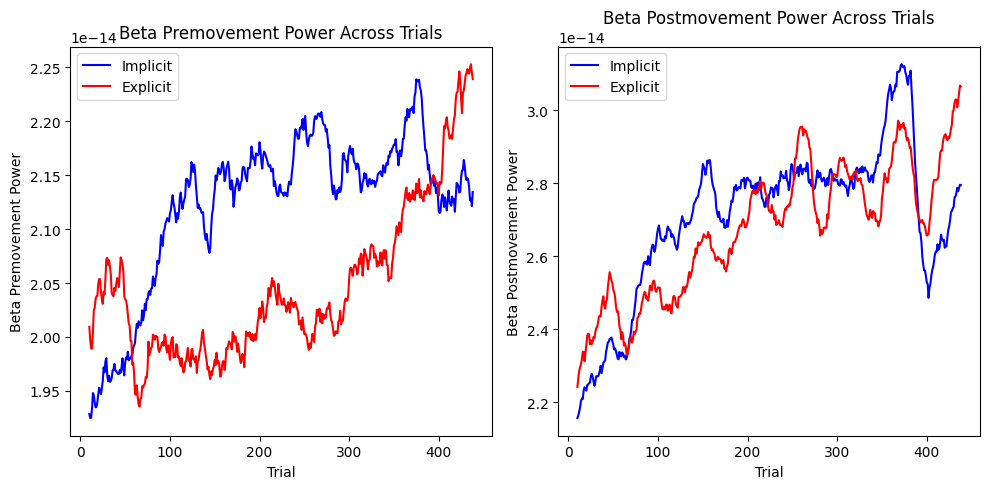

In [10]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

# Define sliding mean function
def sliding_mean(data, window_size):
    return data.rolling(window=window_size, center=True).mean()

# Define function to remove outliers using IQR
def remove_outliers(series):
    Q1 = series.quantile(0.25)
    Q3 = series.quantile(0.75)
    IQR = Q3 - Q1
    lower_bound = Q1 - 1.5 * IQR
    upper_bound = Q3 + 1.5 * IQR
    return series[(series >= lower_bound) & (series <= upper_bound)]

# Define window size for smoothing
window_size = 20  # Adjust as needed

# Remove outliers before computing mean over subjects
df_data_implicit_beta['beta_premovement_power'] = df_data_implicit_beta.groupby('trial')['beta_premovement_power'].transform(remove_outliers)
df_data_implicit_beta['beta_postmovement_power'] = df_data_implicit_beta.groupby('trial')['beta_postmovement_power'].transform(remove_outliers)

df_data_explicit_beta['beta_premovement_power'] = df_data_explicit_beta.groupby('trial')['beta_premovement_power'].transform(remove_outliers)
df_data_explicit_beta['beta_postmovement_power'] = df_data_explicit_beta.groupby('trial')['beta_postmovement_power'].transform(remove_outliers)

# Compute mean beta power across subjects for each trial
mean_premovement_implicit = df_data_implicit_beta.groupby('trial')['beta_premovement_power'].mean()
mean_postmovement_implicit = df_data_implicit_beta.groupby('trial')['beta_postmovement_power'].mean()

mean_premovement_explicit = df_data_explicit_beta.groupby('trial')['beta_premovement_power'].mean()
mean_postmovement_explicit = df_data_explicit_beta.groupby('trial')['beta_postmovement_power'].mean()

# Apply sliding mean to smooth across trials
smooth_premovement_implicit = sliding_mean(mean_premovement_implicit, window_size)
smooth_postmovement_implicit = sliding_mean(mean_postmovement_implicit, window_size)

smooth_premovement_explicit = sliding_mean(mean_premovement_explicit, window_size)
smooth_postmovement_explicit = sliding_mean(mean_postmovement_explicit, window_size)

# Set trial range
trials = np.arange(0, 448)  # Ensure trials are from 0 to 447

# Plot the results
plt.figure(figsize=(10, 5))

# Premovement power
plt.subplot(1, 2, 1)
plt.plot(trials, smooth_premovement_implicit, label='Implicit', color='blue')
plt.plot(trials, smooth_premovement_explicit, label='Explicit', color='red')
plt.xlabel('Trial')
plt.ylabel('Beta Premovement Power')
plt.title('Beta Premovement Power Across Trials')
plt.legend()

# Postmovement power
plt.subplot(1, 2, 2)
plt.plot(trials, smooth_postmovement_implicit, label='Implicit', color='blue')
plt.plot(trials, smooth_postmovement_explicit, label='Explicit', color='red')
plt.xlabel('Trial')
plt.ylabel('Beta Postmovement Power')
plt.title('Beta Postmovement Power Across Trials')
plt.legend()

plt.tight_layout()
plt.show()


In [11]:
# Define coherence categories
cohcats = ["zero", "low", "med", "high"]

# Extract coherence data **per subject** from the final dataframe
implicit_task_mot_coh = {coh: {} for coh in cohcats}
explicit_task_mot_coh = {coh: {} for coh in cohcats}

for coh in cohcats:
    for subject in final_df['subject'].unique():
        implicit_trials = []
        explicit_trials = []

        for i in range(1, 7):  # Blocks 1-5
            implicit_subset = final_df[(final_df['group'] == 'Implicit') & 
                                       (final_df['block'] == i) & 
                                       (final_df['coh_cat'] == coh) & 
                                       (final_df['subject'] == subject)]['meg_signal'].values

            explicit_subset = final_df[(final_df['group'] == 'Explicit') & 
                                       (final_df['block'] == i) & 
                                       (final_df['coh_cat'] == coh) & 
                                       (final_df['subject'] == subject)]['meg_signal'].values

            if len(implicit_subset) > 0:
                implicit_trials.append(np.stack(implicit_subset).mean(axis=0))

            if len(explicit_subset) > 0:
                explicit_trials.append(np.stack(explicit_subset).mean(axis=0))

        # Compute subject-wise average before baseline correction
        if implicit_trials:
            subject_avg = np.mean(implicit_trials, axis=0)
            baseline_value = np.mean(subject_avg[baseline_mask])  # Compute baseline mean
            
            implicit_task_mot_coh[coh][subject] = 100 * (subject_avg - baseline_value) / abs(baseline_value)

        if explicit_trials:
            subject_avg = np.mean(explicit_trials, axis=0)
            baseline_value = np.mean(subject_avg[baseline_mask])  # Compute baseline mean
            
            explicit_task_mot_coh[coh][subject] = 100 * (subject_avg - baseline_value) / abs(baseline_value)
           

# Convert dictionaries to NumPy arrays (preserving subject dimension)
implicit_task_mot_zero = np.stack(list(implicit_task_mot_coh["zero"].values()))[:, plot_mask]
implicit_task_mot_low = np.stack(list(implicit_task_mot_coh["low"].values()))[:, plot_mask]
implicit_task_mot_med = np.stack(list(implicit_task_mot_coh["med"].values()))[:, plot_mask]
implicit_task_mot_high = np.stack(list(implicit_task_mot_coh["high"].values()))[:, plot_mask]

explicit_task_mot_zero = np.stack(list(explicit_task_mot_coh["zero"].values()))[:, plot_mask]
explicit_task_mot_low = np.stack(list(explicit_task_mot_coh["low"].values()))[:, plot_mask]
explicit_task_mot_med = np.stack(list(explicit_task_mot_coh["med"].values()))[:, plot_mask]
explicit_task_mot_high = np.stack(list(explicit_task_mot_coh["high"].values()))[:, plot_mask]


In [12]:
time_plot

array([-0.75      , -0.74833333, -0.74666667, ...,  0.99666667,
        0.99833333,  1.        ])

Using a threshold of 4.121338
stat_fun(H1): min=0.000000 max=1.804021
Running initial clustering …
Found 0 clusters
Using a threshold of 4.121338
stat_fun(H1): min=-0.000020 max=3.184109
Running initial clustering …
Found 0 clusters
Using a threshold of 4.121338


C:\Users\qmoreau\AppData\Local\Temp\ipykernel_12244\2142148345.py:27: RuntimeWarning: Ignoring argument "tail", performing 1-tailed F-test
  T_obs, clusters, cluster_p_values, H0 = mne.stats.permutation_cluster_test([explicit_data, implicit_data], n_permutations=1000)
C:\Users\qmoreau\AppData\Local\Temp\ipykernel_12244\2142148345.py:27: RuntimeWarning: No clusters found, returning empty H0, clusters, and cluster_pv
  T_obs, clusters, cluster_p_values, H0 = mne.stats.permutation_cluster_test([explicit_data, implicit_data], n_permutations=1000)
C:\Users\qmoreau\AppData\Local\Temp\ipykernel_12244\2142148345.py:27: RuntimeWarning: Ignoring argument "tail", performing 1-tailed F-test
  T_obs, clusters, cluster_p_values, H0 = mne.stats.permutation_cluster_test([explicit_data, implicit_data], n_permutations=1000)
C:\Users\qmoreau\AppData\Local\Temp\ipykernel_12244\2142148345.py:27: RuntimeWarning: No clusters found, returning empty H0, clusters, and cluster_pv
  T_obs, clusters, cluster_p_val

stat_fun(H1): min=-0.000003 max=3.870120
Running initial clustering …
Found 0 clusters
Using a threshold of 3.168246
stat_fun(H1): min=0.069563 max=5.120691
Running initial clustering …
Found 5 clusters


C:\Users\qmoreau\AppData\Local\Temp\ipykernel_12244\2142148345.py:27: RuntimeWarning: No clusters found, returning empty H0, clusters, and cluster_pv
  T_obs, clusters, cluster_p_values, H0 = mne.stats.permutation_cluster_test([explicit_data, implicit_data], n_permutations=1000)
C:\Users\qmoreau\AppData\Local\Temp\ipykernel_12244\2142148345.py:53: RuntimeWarning: Ignoring argument "tail", performing 1-tailed F-test
  T_obs, clusters, cluster_p_values, H0 = mne.stats.permutation_cluster_test([data_masked[0], data_masked[1], data_masked[2]], n_permutations=10000)


  0%|          | Permuting : 0/9999 [00:00<?,       ?it/s]

Using a threshold of 3.178799
stat_fun(H1): min=0.033240 max=4.300080
Running initial clustering …
Found 2 clusters


C:\Users\qmoreau\AppData\Local\Temp\ipykernel_12244\2142148345.py:53: RuntimeWarning: Ignoring argument "tail", performing 1-tailed F-test
  T_obs, clusters, cluster_p_values, H0 = mne.stats.permutation_cluster_test([data_masked[0], data_masked[1], data_masked[2]], n_permutations=10000)


  0%|          | Permuting : 0/9999 [00:00<?,       ?it/s]

Using a threshold of 2.731807
stat_fun(H1): min=0.015130 max=1.794371
Running initial clustering …
Found 0 clusters
Using a threshold of 2.739502
stat_fun(H1): min=0.000995 max=2.673947
Running initial clustering …
Found 0 clusters


C:\Users\qmoreau\AppData\Local\Temp\ipykernel_12244\2142148345.py:79: RuntimeWarning: Ignoring argument "tail", performing 1-tailed F-test
  T_obs, clusters, cluster_p_values, H0 = mne.stats.permutation_cluster_test(data_masked, n_permutations=10000)
C:\Users\qmoreau\AppData\Local\Temp\ipykernel_12244\2142148345.py:79: RuntimeWarning: No clusters found, returning empty H0, clusters, and cluster_pv
  T_obs, clusters, cluster_p_values, H0 = mne.stats.permutation_cluster_test(data_masked, n_permutations=10000)
C:\Users\qmoreau\AppData\Local\Temp\ipykernel_12244\2142148345.py:79: RuntimeWarning: Ignoring argument "tail", performing 1-tailed F-test
  T_obs, clusters, cluster_p_values, H0 = mne.stats.permutation_cluster_test(data_masked, n_permutations=10000)
C:\Users\qmoreau\AppData\Local\Temp\ipykernel_12244\2142148345.py:79: RuntimeWarning: No clusters found, returning empty H0, clusters, and cluster_pv
  T_obs, clusters, cluster_p_values, H0 = mne.stats.permutation_cluster_test(data_mask

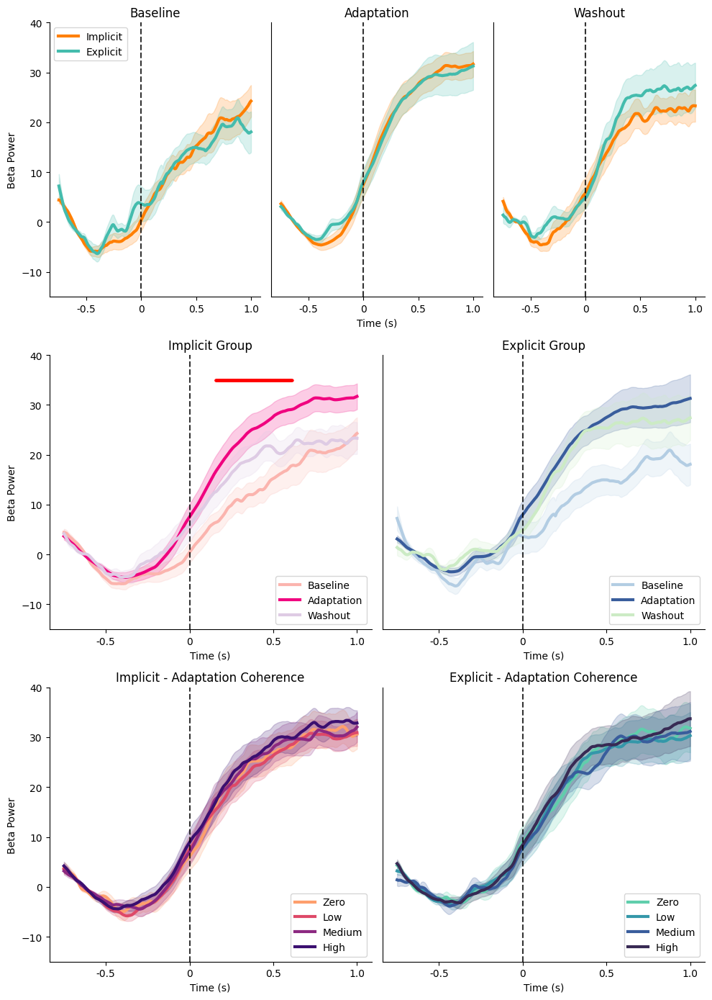

In [13]:

# Define color palettes
colors0 = sns.color_palette("magma", n_colors=6)
colors1 = sns.color_palette("mako_r", n_colors=10)
pastel = sns.color_palette("Pastel1", n_colors=6)
adapt1 = sns.color_palette("Set1", n_colors=9)
adapt2 = sns.color_palette("Accent", n_colors=8)
colors4 = sns.color_palette("magma_r", n_colors=4)  # Implicit coherence
colors5 = sns.color_palette("mako_r", n_colors=4)  # Explicit coherence

# Matching colors
colors_implicit = [pastel[0], adapt2[5], pastel[3]]  # Baseline, Washout, Adaptation
colors_explicit = [pastel[1], colors5[2], pastel[2]]  # Baseline, Washout, Adaptation
colorbl = [adapt1[4], colors1[2]]  # Colors for explicit vs implicit comparison

# Function for **Between-Group (Implicit vs Explicit) Comparison**
def plot_and_cluster_data_blocktype(ax, time_range, data, colors, title, xlabel, ylabel):
    data_masked = [d[:, :len(time_range)] for d in data]
    implicit_data, explicit_data = data_masked  

    for i, (name, d) in enumerate(zip(['Implicit', 'Explicit'], data_masked)):
        mean_curve = np.mean(d, axis=0)
        ax.plot(time_range, mean_curve, label=name, color=colors[i], linewidth=3)
        ax.fill_between(time_range, mean_curve - np.std(d, axis=0) / np.sqrt(d.shape[0]), 
                        mean_curve + np.std(d, axis=0) / np.sqrt(d.shape[0]), alpha=0.2, color=colors[i])

    # Cluster-based permutation test
    T_obs, clusters, cluster_p_values, H0 = mne.stats.permutation_cluster_test([explicit_data, implicit_data], n_permutations=1000)
    sig_masks = [clusters[i][0] for i in range(len(cluster_p_values)) if cluster_p_values[i] < 0.05]

    if len(sig_masks) > 0:
        for i, mask in enumerate(sig_masks):
            sig_indices = mask
            for sig_index in sig_indices:
                ax.plot(time_range[sig_index], 30, '.', color='red', markersize=4, alpha=0.8)

    ax.set_xlabel(xlabel)
    ax.set_ylabel(ylabel)
    ax.set_title(title)
    ax.legend(loc='lower left')

# Function for **Within-Group (Implicit/Explicit Separately) Comparison**
def plot_and_cluster_data_blocktype_within_group(ax, time_range, data, colors, title, xlabel, ylabel):
    data_masked = [d[:, :len(time_range)] for d in data]
    condition_names = ["Baseline","Adaptation",  "Washout"]

    for i, (name, d) in enumerate(zip(condition_names, data_masked)):
        mean_curve = np.mean(d, axis=0)
        ax.plot(time_range, mean_curve, label=name, color=colors[i], linewidth=3)
        ax.fill_between(time_range, mean_curve - np.std(d, axis=0) / np.sqrt(d.shape[0]), 
                        mean_curve + np.std(d, axis=0) / np.sqrt(d.shape[0]), alpha=0.2, color=colors[i])

    # Cluster-based permutation test
    T_obs, clusters, cluster_p_values, H0 = mne.stats.permutation_cluster_test([data_masked[0], data_masked[1], data_masked[2]], n_permutations=10000)
    sig_masks = [clusters[i][0] for i in range(len(cluster_p_values)) if cluster_p_values[i] < 0.05]

    if len(sig_masks) > 0:
        for i, mask in enumerate(sig_masks):
            sig_indices = mask
            for sig_index in sig_indices:
                ax.plot(time_range[sig_index], 35, '.', color='red', markersize= 4, alpha=0.8)

    ax.set_xlabel(xlabel)
    ax.set_ylabel(ylabel)
    ax.set_title(title)
    ax.legend(loc='lower right')

# Function for **Coherence Level Analysis**
def plot_and_cluster_data_coh(ax, time_range, data, colors, title, xlabel, ylabel):
    data_masked = [d[:, :len(time_range)] for d in data]
    coherence_names = ["Zero", "Low", "Medium", "High"]

    for i, (name, d) in enumerate(zip(coherence_names, data_masked)):
        mean_curve = np.nanmean(d, axis=0)
        sem_curve = sem(d, axis=0, nan_policy='omit')
        ax.plot(time_range, mean_curve, label=name, color=colors[i], linewidth=3)
        ax.fill_between(time_range, mean_curve - sem_curve, mean_curve + sem_curve, alpha=0.2, color=colors[i])

    # Cluster-based permutation test
    T_obs, clusters, cluster_p_values, H0 = mne.stats.permutation_cluster_test(data_masked, n_permutations=10000)
    sig_masks = [clusters[i][0] for i in range(len(cluster_p_values)) if cluster_p_values[i] < 0.05]

    if len(sig_masks) > 0:
        for i, mask in enumerate(sig_masks):
            sig_indices = mask
            for sig_index in sig_indices:
                ax.plot(time_range[sig_index], 40, '.', color='red', markersize=4, alpha=0.8)

    ax.set_xlabel(xlabel)
    ax.set_ylabel(ylabel)
    ax.set_title(title)
    ax.legend(loc='lower right')

# Create **Figure with Three Rows**
fig = plt.figure(figsize=(10, 14))
gs = fig.add_gridspec(3, 6)  

# **First Row: Implicit vs Explicit Comparison**
ax1 = fig.add_subplot(gs[0, :2])  
ax2 = fig.add_subplot(gs[0, 2:4])  
ax3 = fig.add_subplot(gs[0, 4:6])  
plot_and_cluster_data_blocktype(ax1, time_plot, [implicit_baseline_array, explicit_baseline_array], colorbl, "Baseline", "", "Beta Power")
plot_and_cluster_data_blocktype(ax2, time_plot, [implicit_adaptation_array, explicit_adaptation_array], colorbl, "Adaptation", "Time (s)", "")
plot_and_cluster_data_blocktype(ax3, time_plot, [implicit_washout_array, explicit_washout_array], colorbl, "Washout", "", "")

# axis 1 put legend top left
ax1.legend(loc='upper left')

# set the ylim for ax4 and ax5
ax1.set_ylim(-15, 40)
ax2.set_ylim(-15, 40)
ax3.set_ylim(-15, 40)

# remove y-ticks for ax2 and ax3
ax2.set_yticks([])
ax3.set_yticks([])

# remove legend from ax2 and ax3
ax2.get_legend().remove()
ax3.get_legend().remove()


# **Second Row: Within-Group Comparison**
ax4 = fig.add_subplot(gs[1, :3])  
ax5 = fig.add_subplot(gs[1, 3:])  
plot_and_cluster_data_blocktype_within_group(ax4, time_plot, [implicit_baseline_array, implicit_adaptation_array, implicit_washout_array], colors_implicit, "Implicit Group", "Time (s)", "Beta Power")
plot_and_cluster_data_blocktype_within_group(ax5, time_plot, [explicit_baseline_array, explicit_adaptation_array, explicit_washout_array], colors_explicit, "Explicit Group", "Time (s)", "")

# set the ylim for ax4 and ax5
ax4.set_ylim(-15, 40)
ax5.set_ylim(-15, 40)

# remove y-ticks for ax5
ax5.set_yticks([])

# **Third Row: Coherence Level Analysis**
ax6 = fig.add_subplot(gs[2, :3])  
ax7 = fig.add_subplot(gs[2, 3:])  
plot_and_cluster_data_coh(ax6, time_plot, [implicit_task_mot_zero, implicit_task_mot_low, implicit_task_mot_med, implicit_task_mot_high], colors4, "Implicit - Adaptation Coherence", "Time (s)", "Beta Power")
plot_and_cluster_data_coh(ax7, time_plot, [explicit_task_mot_zero, explicit_task_mot_low, explicit_task_mot_med, explicit_task_mot_high], colors5, "Explicit - Adaptation Coherence", "Time (s)", "")

# set the ylim for ax6 and ax7
ax6.set_ylim(-15, 40)
ax7.set_ylim(-15, 40)

# remove y-ticks for ax5
ax7.set_yticks([])

# remove right and top spines from all axes
for ax in [ax1, ax2, ax3, ax4, ax5, ax6, ax7]:
    ax.spines['right'].set_visible(False)
    ax.spines['top'].set_visible(False)
    ax.set_xticks([-0.5, 0, 0.5, 1])  # Explicitly set tick positions
    ax.set_xticklabels(["-0.5", "0", "0.5", "1.0"])  # Ensure correct labels
    ax.axvline(x=0, linestyle='dashed', color='black', alpha=0.8)  # Add vertical dashed line
    ax.spines['right'].set_visible(False)
    ax.spines['top'].set_visible(False)
    
plt.tight_layout()
plt.show()


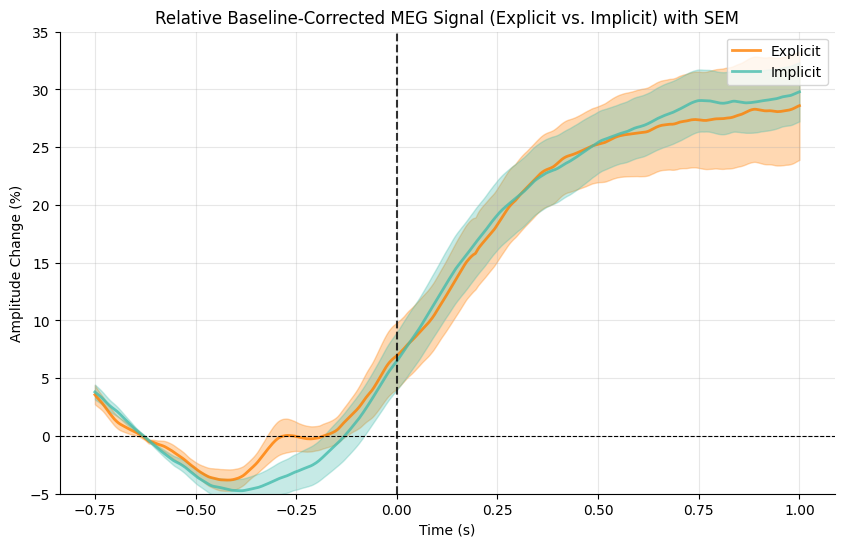

In [14]:
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from scipy.stats import sem  # Standard Error of the Mean

# Define color palettes
colors0 = sns.color_palette("magma", n_colors=6)
colors1 = sns.color_palette("mako_r", n_colors=10)
pastel = sns.color_palette("Pastel1", n_colors=6)
adapt1 = sns.color_palette("Set1", n_colors=9)
adapt2 = sns.color_palette("Accent", n_colors=8)
colors4 = sns.color_palette("magma_r", n_colors=4)
colors5 = sns.color_palette("mako_r", n_colors=4)

colors2 = [pastel[0], pastel[3], adapt2[5]]
colors3 = [pastel[1], pastel[2], colors5[2]]
colorbl = [adapt1[4], colors1[2]]  # Blue-Red scheme for Explicit vs. Implicit

# Define baseline period and plotting window
baseline_mask = (time >= -0.75) & (time <= -0.5)
plot_mask = (time >= -0.75) & (time <= 1)

# Separate groups
explicit_df = final_df[final_df['group'] == 'Explicit']
implicit_df = final_df[final_df['group'] == 'Implicit']

subject_explicit = explicit_df['subject'].unique()
subject_implicit = implicit_df['subject'].unique()

# Compute subject-level averages with baseline correction
explicit_subject_data = {}
implicit_subject_data = {}

for subject in subject_explicit:
    subj_data = explicit_df[explicit_df['subject'] == subject]
    if not subj_data.empty:
        subject_meg = np.stack(subj_data['meg_signal'].values)
        subject_avg = subject_meg.mean(axis=0)
        baseline_value = np.mean(subject_avg[baseline_mask])
        subject_corrected = 100 * (subject_avg - baseline_value) / abs(baseline_value) if baseline_value != 0 else subject_avg
        explicit_subject_data[subject] = subject_corrected

for subject in subject_implicit:
    subj_data = implicit_df[implicit_df['subject'] == subject]
    if not subj_data.empty:
        subject_meg = np.stack(subj_data['meg_signal'].values)
        subject_avg = subject_meg.mean(axis=0)
        baseline_value = np.mean(subject_avg[baseline_mask])
        subject_corrected = 100 * (subject_avg - baseline_value) / abs(baseline_value) if baseline_value != 0 else subject_avg
        implicit_subject_data[subject] = subject_corrected

# Convert subject data to numpy arrays
explicit_array = np.stack(list(explicit_subject_data.values()))
implicit_array = np.stack(list(implicit_subject_data.values()))

# Compute mean and SEM
explicit_subject_avg = explicit_array.mean(axis=0)
implicit_subject_avg = implicit_array.mean(axis=0)

explicit_sem = sem(explicit_array, axis=0)  # SEM across subjects
implicit_sem = sem(implicit_array, axis=0)

# Apply plot mask
time_plot = time[plot_mask]
explicit_plot = explicit_subject_avg[plot_mask]
implicit_plot = implicit_subject_avg[plot_mask]

explicit_sem_plot = explicit_sem[plot_mask]
implicit_sem_plot = implicit_sem[plot_mask]

# Create figure
fig = plt.figure(figsize=(10, 6))
ax = fig.add_subplot(1, 1, 1)  # Single plot

# Plot Explicit and Implicit with SEM shading
ax.plot(time_plot, explicit_plot, label="Explicit", color=colorbl[0], alpha=0.8, linewidth=2)
ax.fill_between(time_plot, explicit_plot - explicit_sem_plot, explicit_plot + explicit_sem_plot, color=colorbl[0], alpha=0.3)

ax.plot(time_plot, implicit_plot, label="Implicit", color=colorbl[1], alpha=0.8, linewidth=2)
ax.fill_between(time_plot, implicit_plot - implicit_sem_plot, implicit_plot + implicit_sem_plot, color=colorbl[1], alpha=0.3)

# Aesthetic adjustments
ax.axhline(0, color='black', linestyle='--', linewidth=0.8)  # Reference line at 0%
ax.axvline(x=0, linestyle='dashed', color='black', alpha=0.8)  # Event onset
ax.set_ylim(-5, 35)
ax.set_xlabel("Time (s)")
ax.set_ylabel("Amplitude Change (%)")
ax.set_title("Relative Baseline-Corrected MEG Signal (Explicit vs. Implicit) with SEM")
ax.legend(loc='upper right')
ax.spines['right'].set_visible(False)
ax.spines['top'].set_visible(False)
ax.grid(True, alpha=0.3)

plt.show()


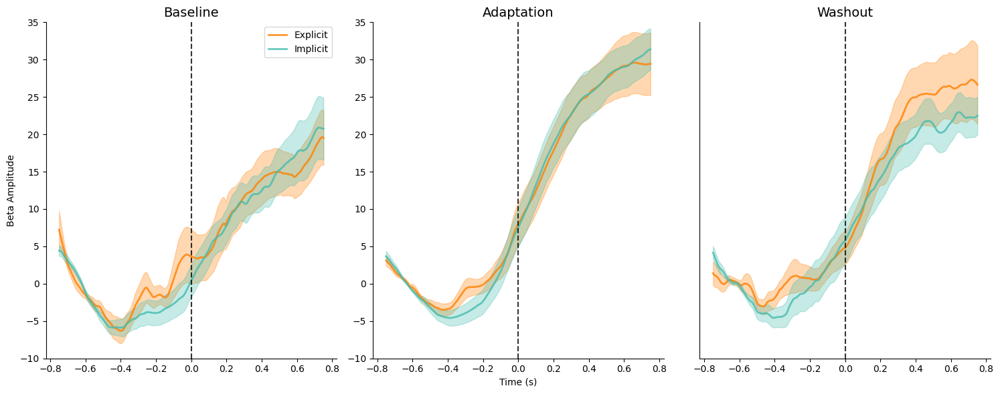

In [15]:
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from scipy.stats import sem  # Standard Error of the Mean

# Define color palettes
colors0 = sns.color_palette("magma", n_colors=6)
colors1 = sns.color_palette("mako_r", n_colors=10)
pastel = sns.color_palette("Pastel1", n_colors=6)
adapt1 = sns.color_palette("Set1", n_colors=9)
adapt2 = sns.color_palette("Accent", n_colors=8)
colors4 = sns.color_palette("magma_r", n_colors=4)
colors5 = sns.color_palette("mako_r", n_colors=4)

colors2 = [pastel[0], pastel[3], adapt2[5]]
colors3 = [pastel[1], pastel[2], colors5[2]]
colorbl = [adapt1[4], colors1[2]]  # Blue-Red scheme for Explicit vs. Implicit

# Define baseline period and plotting window
baseline_mask = (time >= -0.75) & (time <= -0.5)
plot_mask = (time >= -0.75) & (time <= 0.75)

# Function to process a given block selection
def process_block(block_filter):
    explicit_df = final_df[(final_df['group'] == 'Explicit') & (final_df['block'].isin(block_filter))]
    implicit_df = final_df[(final_df['group'] == 'Implicit') & (final_df['block'].isin(block_filter))]

    subject_explicit = explicit_df['subject'].unique()
    subject_implicit = implicit_df['subject'].unique()

    explicit_subject_data = {}
    implicit_subject_data = {}

    for subject in subject_explicit:
        subj_data = explicit_df[explicit_df['subject'] == subject]
        if not subj_data.empty:
            subject_meg = np.stack(subj_data['meg_signal'].values)
            subject_avg = subject_meg.mean(axis=0)
            baseline_value = np.mean(subject_avg[baseline_mask])
            subject_corrected = 100 * (subject_avg - baseline_value) / abs(baseline_value) if baseline_value != 0 else subject_avg
            explicit_subject_data[subject] = subject_corrected

    for subject in subject_implicit:
        subj_data = implicit_df[implicit_df['subject'] == subject]
        if not subj_data.empty:
            subject_meg = np.stack(subj_data['meg_signal'].values)
            subject_avg = subject_meg.mean(axis=0)
            baseline_value = np.mean(subject_avg[baseline_mask])
            subject_corrected = 100 * (subject_avg - baseline_value) / abs(baseline_value) if baseline_value != 0 else subject_avg
            implicit_subject_data[subject] = subject_corrected

    explicit_array = np.stack(list(explicit_subject_data.values()))
    implicit_array = np.stack(list(implicit_subject_data.values()))

    explicit_subject_avg = explicit_array.mean(axis=0)
    implicit_subject_avg = implicit_array.mean(axis=0)

    explicit_sem = sem(explicit_array, axis=0)
    implicit_sem = sem(implicit_array, axis=0)

    time_plot = time[plot_mask]
    explicit_plot = explicit_subject_avg[plot_mask]
    implicit_plot = implicit_subject_avg[plot_mask]
    explicit_sem_plot = explicit_sem[plot_mask]
    implicit_sem_plot = implicit_sem[plot_mask]

    return time_plot, explicit_plot, implicit_plot, explicit_sem_plot, implicit_sem_plot

# Get data for each phase
time_baseline, explicit_baseline, implicit_baseline, explicit_baseline_sem, implicit_baseline_sem = process_block([0])
time_adaptation, explicit_adaptation, implicit_adaptation, explicit_adaptation_sem, implicit_adaptation_sem = process_block([1, 2, 3, 4, 5, 6])
time_washout, explicit_washout, implicit_washout, explicit_washout_sem, implicit_washout_sem = process_block([7])

# Create figure and grid layout
fig = plt.figure(figsize=(15, 6))  # Wide format for three subplots in a row
gs = fig.add_gridspec(1, 6)  # One row, six columns

# Create subplots that span 2 columns each
ax1 = fig.add_subplot(gs[0, :2])  # Baseline
ax2 = fig.add_subplot(gs[0, 2:4])  # Adaptation
ax3 = fig.add_subplot(gs[0, 4:6])  # Washout

# Data and titles
axes = [ax1, ax2, ax3]
titles = ["Baseline", "Adaptation", "Washout"]
data = [
    (time_baseline, explicit_baseline, implicit_baseline, explicit_baseline_sem, implicit_baseline_sem),
    (time_adaptation, explicit_adaptation, implicit_adaptation, explicit_adaptation_sem, implicit_adaptation_sem),
    (time_washout, explicit_washout, implicit_washout, explicit_washout_sem, implicit_washout_sem),
]

# Plotting loop
for ax, (time_plot, explicit_plot, implicit_plot, explicit_sem_plot, implicit_sem_plot), title in zip(axes, data, titles):
    # Explicit
    ax.plot(time_plot, explicit_plot, label="Explicit", color=colorbl[0], alpha=0.8, linewidth=2)
    ax.fill_between(time_plot, explicit_plot - explicit_sem_plot, explicit_plot + explicit_sem_plot, color=colorbl[0], alpha=0.3)

    # Implicit
    ax.plot(time_plot, implicit_plot, label="Implicit", color=colorbl[1], alpha=0.8, linewidth=2)
    ax.fill_between(time_plot, implicit_plot - implicit_sem_plot, implicit_plot + implicit_sem_plot, color=colorbl[1], alpha=0.3)

    # Styling
    ax.axvline(x=0, linestyle='dashed', color='black', alpha=0.8)  # Event onset
    ax.set_ylim(-10, 35)
    ax.set_title(title, fontsize=14)
    ax.spines['right'].set_visible(False)
    ax.spines['top'].set_visible(False)

# Axis labels
ax1.set_ylabel("Beta Amplitude")
ax2.set_xlabel("Time (s)")
ax3.set_yticks([])  # Remove y-ticks from rightmost plot

# Only keep legend in the first plot
ax1.legend(loc='upper right')

plt.tight_layout()
plt.show()


Using a threshold of 4.121338
stat_fun(H1): min=0.000000 max=1.804021
Running initial clustering …
Found 0 clusters

=== Cluster-based Permutation Test Results ===
Total clusters detected: 0
Cluster p-values: []
Using a threshold of 4.121338
stat_fun(H1): min=-0.000020 max=3.184109
Running initial clustering …
Found 0 clusters

=== Cluster-based Permutation Test Results ===
Total clusters detected: 0
Cluster p-values: []
Using a threshold of 4.121338
stat_fun(H1): min=-0.000003 max=3.870120
Running initial clustering …
Found 0 clusters


C:\Users\qmoreau\AppData\Local\Temp\ipykernel_12244\4081496084.py:16: RuntimeWarning: Ignoring argument "tail", performing 1-tailed F-test
  T_obs, clusters, cluster_p_values, H0 = mne.stats.permutation_cluster_test(
C:\Users\qmoreau\AppData\Local\Temp\ipykernel_12244\4081496084.py:16: RuntimeWarning: No clusters found, returning empty H0, clusters, and cluster_pv
  T_obs, clusters, cluster_p_values, H0 = mne.stats.permutation_cluster_test(
C:\Users\qmoreau\AppData\Local\Temp\ipykernel_12244\4081496084.py:16: RuntimeWarning: Ignoring argument "tail", performing 1-tailed F-test
  T_obs, clusters, cluster_p_values, H0 = mne.stats.permutation_cluster_test(
C:\Users\qmoreau\AppData\Local\Temp\ipykernel_12244\4081496084.py:16: RuntimeWarning: No clusters found, returning empty H0, clusters, and cluster_pv
  T_obs, clusters, cluster_p_values, H0 = mne.stats.permutation_cluster_test(
C:\Users\qmoreau\AppData\Local\Temp\ipykernel_12244\4081496084.py:16: RuntimeWarning: Ignoring argument "tail"


=== Cluster-based Permutation Test Results ===
Total clusters detected: 0
Cluster p-values: []


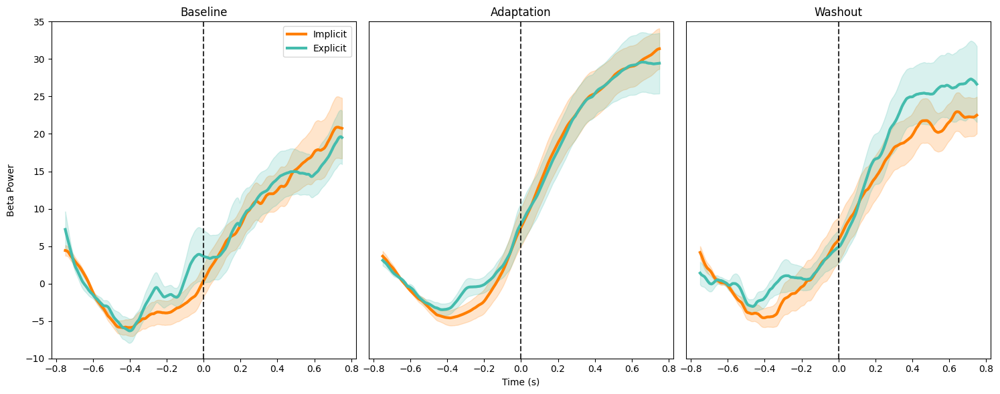

In [16]:
def plot_and_cluster_data_blocktype(ax, time_range, data, colors, title, xlabel, ylabel):
    # Ensure data dimensions match the time range
    data_masked = [d[:, :len(time_range)] for d in data]
    implicit_data, explicit_data = data_masked  # Extract for clarity

    # Plot the main lines for each condition **with SEM shading**
    for i, (name, d) in enumerate(zip(['Implicit', 'Explicit'], data_masked)):
        mean_curve = np.mean(d, axis=0)
        ax.plot(time_range, mean_curve, label=name, color=colors[i], linewidth=3)
        ax.fill_between(time_range, 
                        mean_curve - np.std(d, axis=0) / np.sqrt(d.shape[0]), 
                        mean_curve + np.std(d, axis=0) / np.sqrt(d.shape[0]), 
                        alpha=0.2, color=colors[i])  # SEM shading stays

    # Perform cluster-based permutation test on difference (Explicit - Implicit)
    T_obs, clusters, cluster_p_values, H0 = mne.stats.permutation_cluster_test(
        [explicit_data, implicit_data], n_permutations=1000)

    print(f"\n=== Cluster-based Permutation Test Results ===")
    print(f"Total clusters detected: {len(clusters)}")
    print(f"Cluster p-values: {cluster_p_values}")

    # Identify significant clusters
    sig_masks = [clusters[i][0] for i in range(len(cluster_p_values)) if cluster_p_values[i] < 0.05]  # FIX HERE

    if len(sig_masks) > 0:
        print(f"Significant clusters found! {len(sig_masks)} clusters detected.")

        for i, mask in enumerate(sig_masks):
            sig_indices = mask  # FIX: Extract indices directly instead of tuple
            sig_times = time_range[sig_indices]  # Convert indices to timepoints
            
            # **Properly extract the range**
            start_time, end_time = sig_times[0], sig_times[-1]
            print(f"\n--- Cluster {i+1} Details ---")
            print(f"Significant Time Points Count: {len(sig_times)}")
            print(f"Significant Time Range: {start_time:.3f} to {end_time:.3f} sec")  # FIX HERE

            # **Plot dots at the exact significant time points**
            for sig_index in sig_indices:
                sig_time = time_range[sig_index]
                ax.plot(sig_time, 30, 'o', color='pink', markersize=4, alpha=0.8)

    ax.set_xlabel(xlabel)
    ax.set_ylabel(ylabel, labelpad=10)
    ax.set_title(title)
    ax.legend(loc='lower left')


# Define baseline period and plotting window
baseline_mask = (time >= -0.75) & (time <= -0.5)
plot_mask = (time >= -0.75) & (time <= 0.75)

# Function to process a given block selection
def process_block(block_filter):
    explicit_df = final_df[(final_df['group'] == 'Explicit') & (final_df['block'].isin(block_filter))]
    implicit_df = final_df[(final_df['group'] == 'Implicit') & (final_df['block'].isin(block_filter))]

    explicit_subject_data = {}
    implicit_subject_data = {}

    for subject in explicit_df['subject'].unique():
        subj_data = explicit_df[explicit_df['subject'] == subject]
        if not subj_data.empty:
            subject_meg = np.stack(subj_data['meg_signal'].values)
            subject_avg = subject_meg.mean(axis=0)
            baseline_value = np.mean(subject_avg[baseline_mask])
            explicit_subject_data[subject] = 100 * (subject_avg - baseline_value) / abs(baseline_value) if baseline_value != 0 else subject_avg

    for subject in implicit_df['subject'].unique():
        subj_data = implicit_df[implicit_df['subject'] == subject]
        if not subj_data.empty:
            subject_meg = np.stack(subj_data['meg_signal'].values)
            subject_avg = subject_meg.mean(axis=0)
            baseline_value = np.mean(subject_avg[baseline_mask])
            implicit_subject_data[subject] = 100 * (subject_avg - baseline_value) / abs(baseline_value) if baseline_value != 0 else subject_avg

    explicit_array = np.stack(list(explicit_subject_data.values()))
    implicit_array = np.stack(list(implicit_subject_data.values()))
    
    time_plot = time[plot_mask]
    explicit_array = explicit_array[:, plot_mask]
    implicit_array = implicit_array[:, plot_mask]

    return time_plot, explicit_array, implicit_array

# Get data for each phase
time_baseline, explicit_baseline_array, implicit_baseline_array = process_block([0])
time_adaptation, explicit_adaptation_array, implicit_adaptation_array = process_block([1, 2, 3, 4, 5, 6])
time_washout, explicit_washout_array, implicit_washout_array = process_block([7])

# Create figure and grid layout
fig = plt.figure(figsize=(15, 6))  # Wide format for three subplots in a row
gs = fig.add_gridspec(1, 6)  # One row, six columns

# Create subplots that span 2 columns each
ax1 = fig.add_subplot(gs[0, :2])  # Baseline
ax2 = fig.add_subplot(gs[0, 2:4])  # Adaptation
ax3 = fig.add_subplot(gs[0, 4:6])  # Washout

# Plot the data using the function with cluster analysis
plot_and_cluster_data_blocktype(ax1, time_baseline, [implicit_baseline_array, explicit_baseline_array], colorbl, "Baseline", "", "Beta Power")
plot_and_cluster_data_blocktype(ax2, time_adaptation, [implicit_adaptation_array, explicit_adaptation_array], colorbl, "Adaptation", "Time (s)", "")
plot_and_cluster_data_blocktype(ax3, time_washout, [implicit_washout_array, explicit_washout_array], colorbl, "Washout", "", "")

# Styling adjustments
ax1.axvline(x=0, linestyle='dashed', color='black', alpha=0.8)  # Event onset
ax2.axvline(x=0, linestyle='dashed', color='black', alpha=0.8)
ax3.axvline(x=0, linestyle='dashed', color='black', alpha=0.8)

ax1.set_ylim(-10, 35)
ax2.set_ylim(-10, 35)
ax3.set_ylim(-10, 35)

ax2.set_yticks([])  
ax3.set_yticks([])  
ax1.legend(loc='upper right')

# Remove legends from the other plots
ax2.get_legend().remove()
ax3.get_legend().remove()

plt.tight_layout()
plt.show()


Using a threshold of 3.168246
stat_fun(H1): min=0.069565 max=5.120703
Running initial clustering …
Found 3 clusters


C:\Users\qmoreau\AppData\Local\Temp\ipykernel_12244\125793816.py:42: RuntimeWarning: Ignoring argument "tail", performing 1-tailed F-test
  T_obs, clusters, cluster_p_values, H0 = mne.stats.permutation_cluster_test(


  0%|          | Permuting : 0/9999 [00:00<?,       ?it/s]


=== Cluster-based Permutation Test Results for Implicit Group: Baseline vs Washout vs Adaptation ===
Total clusters detected: 3
Cluster p-values: [0.3936 0.0301 0.2785]
Significant clusters found! 1 clusters detected.

--- Cluster 1 Details ---
Significant Time Points Count: 275
Significant Time Range: 0.155 to 0.612 sec
Using a threshold of 3.178799
stat_fun(H1): min=0.033240 max=4.300080
Running initial clustering …
Found 2 clusters


C:\Users\qmoreau\AppData\Local\Temp\ipykernel_12244\125793816.py:42: RuntimeWarning: Ignoring argument "tail", performing 1-tailed F-test
  T_obs, clusters, cluster_p_values, H0 = mne.stats.permutation_cluster_test(


  0%|          | Permuting : 0/9999 [00:00<?,       ?it/s]


=== Cluster-based Permutation Test Results for Explicit Group: Baseline vs Washout vs Adaptation ===
Total clusters detected: 2
Cluster p-values: [0.2777 0.0568]


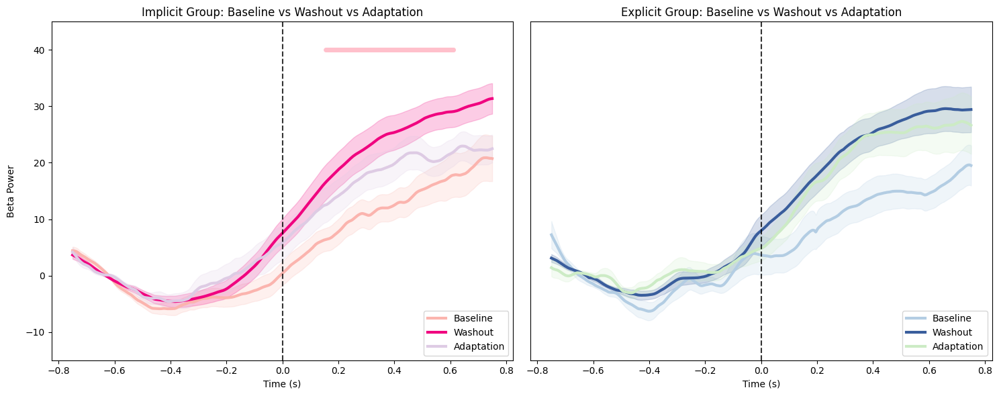

In [17]:
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import mne
from scipy.stats import sem

# Define color palettes (matching the second row of your original layout)
colors0 = sns.color_palette("magma", n_colors=6)
colors1 = sns.color_palette("mako_r", n_colors=10)
pastel = sns.color_palette("Pastel1", n_colors=6)
adapt1 = sns.color_palette("Set1", n_colors=9)
adapt2 = sns.color_palette("Accent", n_colors=8)
colors4 = sns.color_palette("magma_r", n_colors=4)
colors5 = sns.color_palette("mako_r", n_colors=4)

# Matching colors for Implicit & Explicit group plots with Adaptation/Washout reversed
colors_implicit = [pastel[0], adapt2[5], pastel[3]]  # Baseline, **Washout**, **Adaptation**
colors_explicit = [pastel[1], colors5[2], pastel[2]]  # Baseline, **Washout**, **Adaptation**

# Function for plotting and cluster-based analysis within a group
def plot_and_cluster_data_blocktype_within_group(ax, time_range, data, colors, title, xlabel, ylabel):
    """
    Perform cluster-based permutation test within one group (Implicit or Explicit),
    comparing Baseline vs Adaptation vs Washout.
    """
    data_masked = [d[:, :len(time_range)] for d in data]
    baseline_data, adaptation_data, washout_data = data_masked  # Extract for clarity

    # Define condition names
    condition_names = ["Baseline", "Washout", "Adaptation"]  # Swapped order for colors

    # Plot the main lines for each condition **with SEM shading**
    for i, (name, d) in enumerate(zip(condition_names, data_masked)):
        mean_curve = np.mean(d, axis=0)
        ax.plot(time_range, mean_curve, label=name, color=colors[i], linewidth=3)
        ax.fill_between(time_range, 
                        mean_curve - np.std(d, axis=0) / np.sqrt(d.shape[0]), 
                        mean_curve + np.std(d, axis=0) / np.sqrt(d.shape[0]), 
                        alpha=0.2, color=colors[i])

    # Perform cluster-based permutation test across conditions
    T_obs, clusters, cluster_p_values, H0 = mne.stats.permutation_cluster_test(
        [baseline_data, washout_data, adaptation_data], n_permutations=10000)  # Swapped order

    print(f"\n=== Cluster-based Permutation Test Results for {title} ===")
    print(f"Total clusters detected: {len(clusters)}")
    print(f"Cluster p-values: {cluster_p_values}")

    # Identify significant clusters
    sig_masks = [clusters[i][0] for i in range(len(cluster_p_values)) if cluster_p_values[i] < 0.05]

    if len(sig_masks) > 0:
        print(f"Significant clusters found! {len(sig_masks)} clusters detected.")

        for i, mask in enumerate(sig_masks):
            sig_indices = mask  # Extract indices
            sig_times = time_range[sig_indices]  # Convert indices to timepoints
            
            start_time, end_time = sig_times[0], sig_times[-1]
            print(f"\n--- Cluster {i+1} Details ---")
            print(f"Significant Time Points Count: {len(sig_times)}")
            print(f"Significant Time Range: {start_time:.3f} to {end_time:.3f} sec")

            # **Plot dots at the exact significant time points**
            for sig_index in sig_indices:
                sig_time = time_range[sig_index]
                ax.plot(sig_time, 40, 'o', color='pink', markersize=4, alpha=0.8)

    ax.set_xlabel(xlabel)
    ax.set_ylabel(ylabel, labelpad=10)
    ax.set_title(title)
    ax.legend(loc='lower right')

# Create a single figure with two subplots **on the same row**
fig = plt.figure(figsize=(15, 6))
gs = fig.add_gridspec(1, 6)  # One row, 6 columns for equal spacing

ax1 = fig.add_subplot(gs[0, :3])  # Implicit Group
ax2 = fig.add_subplot(gs[0, 3:])  # Explicit Group

# **Plot Implicit Group**
plot_and_cluster_data_blocktype_within_group(ax1, time_baseline, 
                                             [implicit_baseline_array, implicit_adaptation_array, implicit_washout_array], 
                                             colors_implicit, 
                                             "Implicit Group: Baseline vs Washout vs Adaptation", 
                                             "Time (s)", "Beta Power")
ax1.axvline(x=0, linestyle='dashed', color='black', alpha=0.8)  # Event onset
ax1.set_ylim(-15, 45)

# **Plot Explicit Group**
plot_and_cluster_data_blocktype_within_group(ax2, time_baseline, 
                                             [explicit_baseline_array, explicit_adaptation_array, explicit_washout_array], 
                                             colors_explicit, 
                                             "Explicit Group: Baseline vs Washout vs Adaptation", 
                                             "Time (s)", "")
ax2.axvline(x=0, linestyle='dashed', color='black', alpha=0.8)  # Event onset
ax2.set_ylim(-15, 45)
ax2.set_yticks([])  # Remove y-ticks on the right

# Adjust layout
plt.tight_layout()
plt.show()


Using a threshold of 2.667443
stat_fun(H1): min=0.017992 max=1.135379
Running initial clustering …
Found 0 clusters

=== Cluster-based Permutation Test Results for Implicit Group: Adaptation Coherence Levels (Baseline Corrected) ===
Total clusters detected: 0
Cluster p-values: []
Using a threshold of 2.667443
stat_fun(H1): min=0.004315 max=1.167171
Running initial clustering …
Found 0 clusters


C:\Users\qmoreau\AppData\Local\Temp\ipykernel_12244\2117105235.py:93: RuntimeWarning: Ignoring argument "tail", performing 1-tailed F-test
  T_obs, clusters, cluster_p_values, H0 = mne.stats.permutation_cluster_test(
C:\Users\qmoreau\AppData\Local\Temp\ipykernel_12244\2117105235.py:93: RuntimeWarning: No clusters found, returning empty H0, clusters, and cluster_pv
  T_obs, clusters, cluster_p_values, H0 = mne.stats.permutation_cluster_test(
C:\Users\qmoreau\AppData\Local\Temp\ipykernel_12244\2117105235.py:93: RuntimeWarning: Ignoring argument "tail", performing 1-tailed F-test
  T_obs, clusters, cluster_p_values, H0 = mne.stats.permutation_cluster_test(
C:\Users\qmoreau\AppData\Local\Temp\ipykernel_12244\2117105235.py:93: RuntimeWarning: No clusters found, returning empty H0, clusters, and cluster_pv
  T_obs, clusters, cluster_p_values, H0 = mne.stats.permutation_cluster_test(



=== Cluster-based Permutation Test Results for Explicit Group: Adaptation Coherence Levels (Baseline Corrected) ===
Total clusters detected: 0
Cluster p-values: []


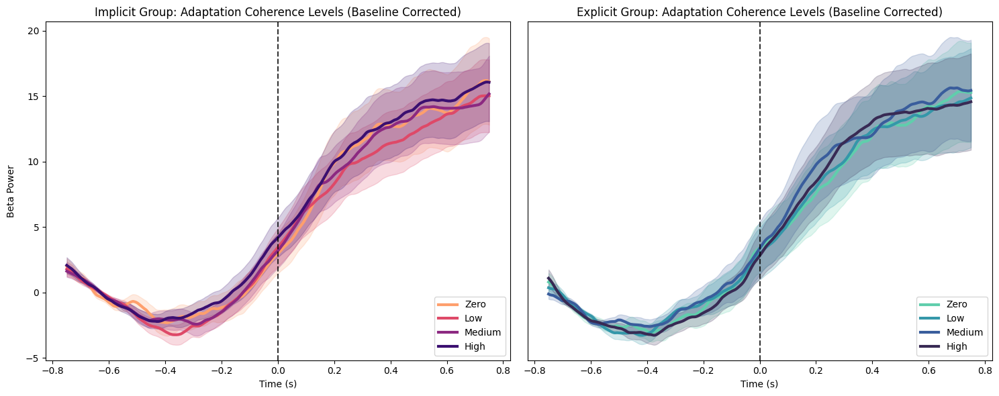

In [18]:
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import mne
from scipy.stats import sem

# Define coherence categories
cohcats = ["zero", "low", "med", "high"]

# Define color palettes (matching the second row of your original layout)
colors4 = sns.color_palette("magma_r", n_colors=4)  # Implicit coherence
colors5 = sns.color_palette("mako_r", n_colors=4)  # Explicit coherence

# Define time masks for baseline and plotting window
baseline_mask = (time >= -0.75) & (time <= -0.5)  # Example baseline window
plot_mask = (time >= -0.75) & (time <= 0.75)  # **Only plot this window**

# Extract coherence data **per subject** from the final dataframe
implicit_task_mot_coh = {coh: {} for coh in cohcats}
explicit_task_mot_coh = {coh: {} for coh in cohcats}

for coh in cohcats:
    for subject in final_df['subject'].unique():
        implicit_trials = []
        explicit_trials = []

        for i in range(1, 6):  # Blocks 1-5
            implicit_subset = final_df[(final_df['group'] == 'Implicit') & 
                                       (final_df['block'] == i) & 
                                       (final_df['coh_cat'] == coh) & 
                                       (final_df['subject'] == subject)]['meg_signal'].values

            explicit_subset = final_df[(final_df['group'] == 'Explicit') & 
                                       (final_df['block'] == i) & 
                                       (final_df['coh_cat'] == coh) & 
                                       (final_df['subject'] == subject)]['meg_signal'].values

            if len(implicit_subset) > 0:
                implicit_trials.append(np.nanmean(np.vstack(implicit_subset), axis=0))

            if len(explicit_subset) > 0:
                explicit_trials.append(np.nanmean(np.vstack(explicit_subset), axis=0))

        # Compute subject-wise baseline correction
        if implicit_trials:
            subject_data = np.nanmean(implicit_trials, axis=0)
            baseline_value = np.nanmean(subject_data[baseline_mask])  # Compute baseline mean
            corrected_data = 100 * (subject_data - baseline_value) / abs(baseline_value) if baseline_value != 0 else subject_data
            implicit_task_mot_coh[coh][subject] = corrected_data
        else:
            implicit_task_mot_coh[coh][subject] = np.zeros(len(time))  # Zero to maintain shape

        if explicit_trials:
            subject_data = np.nanmean(explicit_trials, axis=0)
            baseline_value = np.nanmean(subject_data[baseline_mask])  # Compute baseline mean
            corrected_data = 100 * (subject_data - baseline_value) / abs(baseline_value) if baseline_value != 0 else subject_data
            explicit_task_mot_coh[coh][subject] = corrected_data
        else:
            explicit_task_mot_coh[coh][subject] = np.zeros(len(time))

# Convert dictionaries to NumPy arrays (preserving subject dimension)
implicit_task_mot_zero = np.stack(list(implicit_task_mot_coh["zero"].values()))[:, plot_mask]
implicit_task_mot_low = np.stack(list(implicit_task_mot_coh["low"].values()))[:, plot_mask]
implicit_task_mot_med = np.stack(list(implicit_task_mot_coh["med"].values()))[:, plot_mask]
implicit_task_mot_high = np.stack(list(implicit_task_mot_coh["high"].values()))[:, plot_mask]

explicit_task_mot_zero = np.stack(list(explicit_task_mot_coh["zero"].values()))[:, plot_mask]
explicit_task_mot_low = np.stack(list(explicit_task_mot_coh["low"].values()))[:, plot_mask]
explicit_task_mot_med = np.stack(list(explicit_task_mot_coh["med"].values()))[:, plot_mask]
explicit_task_mot_high = np.stack(list(explicit_task_mot_coh["high"].values()))[:, plot_mask]

# Restrict time range for plotting
time_plot = time[plot_mask]

# Function for plotting coherence levels and running cluster-based analysis
def plot_and_cluster_data_coh(ax, time_range, data, colors, title, xlabel, ylabel):
    """
    Perform cluster-based permutation test within one group (Implicit or Explicit),
    comparing coherence levels (Zero, Low, Medium, High) **while preserving subject data**.
    """
    data_masked = [d[:, :len(time_range)] for d in data]
    coherence_names = ["Zero", "Low", "Medium", "High"]

    # Plot the main lines for each coherence level **with SEM shading**
    for i, (name, d) in enumerate(zip(coherence_names, data_masked)):
        mean_curve = np.nanmean(d, axis=0)  # Use nanmean to avoid NaNs
        sem_curve = sem(d, axis=0, nan_policy='omit')  # Compute SEM across subjects

        ax.plot(time_range, mean_curve, label=name, color=colors[i], linewidth=3)
        ax.fill_between(time_range, mean_curve - sem_curve, mean_curve + sem_curve, alpha=0.2, color=colors[i])

    # Perform cluster-based permutation test across coherence levels (subject-wise)
    T_obs, clusters, cluster_p_values, H0 = mne.stats.permutation_cluster_test(
        data_masked, n_permutations=10000, threshold=None)

    print(f"\n=== Cluster-based Permutation Test Results for {title} ===")
    print(f"Total clusters detected: {len(clusters)}")
    print(f"Cluster p-values: {cluster_p_values}")

    # Identify significant clusters
    sig_masks = [clusters[i][0] for i in range(len(cluster_p_values)) if cluster_p_values[i] < 0.05]

    if len(sig_masks) > 0:
        print(f"Significant clusters found! {len(sig_masks)} clusters detected.")

        for i, mask in enumerate(sig_masks):
            sig_indices = mask  # Extract indices
            sig_times = time_range[sig_indices]  # Convert indices to timepoints
            
            start_time, end_time = sig_times[0], sig_times[-1]
            print(f"\n--- Cluster {i+1} Details ---")
            print(f"Significant Time Points Count: {len(sig_times)}")
            print(f"Significant Time Range: {start_time:.3f} to {end_time:.3f} sec")

            # **Plot dots at the exact significant time points**
            for sig_index in sig_indices:
                sig_time = time_range[sig_index]
                ax.plot(sig_time, 40, 'o', color='pink', markersize=4, alpha=0.8)

    ax.set_xlabel(xlabel)
    ax.set_ylabel(ylabel, labelpad=10)
    ax.set_title(title)
    ax.legend(loc='lower right')

# Create a single figure with two subplots **on the same row**
fig = plt.figure(figsize=(15, 6))
gs = fig.add_gridspec(1, 6)  # One row, 6 columns for equal spacing

ax1 = fig.add_subplot(gs[0, :3])  # Implicit Group Coherence
ax2 = fig.add_subplot(gs[0, 3:])  # Explicit Group Coherence

# **Plot Implicit Group Coherence**
plot_and_cluster_data_coh(ax1, time_plot, 
                          [implicit_task_mot_zero, implicit_task_mot_low, 
                           implicit_task_mot_med, implicit_task_mot_high], 
                          colors4, 
                          "Implicit Group: Adaptation Coherence Levels (Baseline Corrected)", 
                          "Time (s)", "Beta Power")
ax1.axvline(x=0, linestyle='dashed', color='black', alpha=0.8)

# **Plot Explicit Group Coherence**
plot_and_cluster_data_coh(ax2, time_plot, 
                          [explicit_task_mot_zero, explicit_task_mot_low, 
                           explicit_task_mot_med, explicit_task_mot_high], 
                          colors5, 
                          "Explicit Group: Adaptation Coherence Levels (Baseline Corrected)", 
                          "Time (s)", "")
ax2.axvline(x=0, linestyle='dashed', color='black', alpha=0.8)
ax2.set_yticks([])  # Remove y-ticks on the right

plt.tight_layout()
plt.show()


Using a threshold of 4.121338
stat_fun(H1): min=0.000000 max=1.804021
Running initial clustering …
Found 0 clusters
Using a threshold of 4.121338
stat_fun(H1): min=-0.000020 max=3.184109
Running initial clustering …
Found 0 clusters
Using a threshold of 4.121338
stat_fun(H1): min=-0.000003 max=3.870120
Running initial clustering …
Found 0 clusters
Using a threshold of 3.168246
stat_fun(H1): min=0.069563 max=5.120691
Running initial clustering …
Found 3 clusters


C:\Users\qmoreau\AppData\Local\Temp\ipykernel_12244\3412119465.py:37: RuntimeWarning: Ignoring argument "tail", performing 1-tailed F-test
  T_obs, clusters, cluster_p_values, H0 = mne.stats.permutation_cluster_test([explicit_data, implicit_data], n_permutations=1000)
C:\Users\qmoreau\AppData\Local\Temp\ipykernel_12244\3412119465.py:37: RuntimeWarning: No clusters found, returning empty H0, clusters, and cluster_pv
  T_obs, clusters, cluster_p_values, H0 = mne.stats.permutation_cluster_test([explicit_data, implicit_data], n_permutations=1000)
C:\Users\qmoreau\AppData\Local\Temp\ipykernel_12244\3412119465.py:37: RuntimeWarning: Ignoring argument "tail", performing 1-tailed F-test
  T_obs, clusters, cluster_p_values, H0 = mne.stats.permutation_cluster_test([explicit_data, implicit_data], n_permutations=1000)
C:\Users\qmoreau\AppData\Local\Temp\ipykernel_12244\3412119465.py:37: RuntimeWarning: No clusters found, returning empty H0, clusters, and cluster_pv
  T_obs, clusters, cluster_p_val

  0%|          | Permuting : 0/9999 [00:00<?,       ?it/s]

Using a threshold of 3.178799
stat_fun(H1): min=0.033240 max=4.300080
Running initial clustering …
Found 2 clusters


C:\Users\qmoreau\AppData\Local\Temp\ipykernel_12244\3412119465.py:63: RuntimeWarning: Ignoring argument "tail", performing 1-tailed F-test
  T_obs, clusters, cluster_p_values, H0 = mne.stats.permutation_cluster_test([data_masked[0], data_masked[1], data_masked[2]], n_permutations=10000)


  0%|          | Permuting : 0/9999 [00:00<?,       ?it/s]

Using a threshold of 2.667443
stat_fun(H1): min=0.017992 max=1.135379
Running initial clustering …
Found 0 clusters
Using a threshold of 2.667443
stat_fun(H1): min=0.004315 max=1.167171
Running initial clustering …
Found 0 clusters


C:\Users\qmoreau\AppData\Local\Temp\ipykernel_12244\3412119465.py:89: RuntimeWarning: Ignoring argument "tail", performing 1-tailed F-test
  T_obs, clusters, cluster_p_values, H0 = mne.stats.permutation_cluster_test(data_masked, n_permutations=10000)
C:\Users\qmoreau\AppData\Local\Temp\ipykernel_12244\3412119465.py:89: RuntimeWarning: No clusters found, returning empty H0, clusters, and cluster_pv
  T_obs, clusters, cluster_p_values, H0 = mne.stats.permutation_cluster_test(data_masked, n_permutations=10000)
C:\Users\qmoreau\AppData\Local\Temp\ipykernel_12244\3412119465.py:89: RuntimeWarning: Ignoring argument "tail", performing 1-tailed F-test
  T_obs, clusters, cluster_p_values, H0 = mne.stats.permutation_cluster_test(data_masked, n_permutations=10000)
C:\Users\qmoreau\AppData\Local\Temp\ipykernel_12244\3412119465.py:89: RuntimeWarning: No clusters found, returning empty H0, clusters, and cluster_pv
  T_obs, clusters, cluster_p_values, H0 = mne.stats.permutation_cluster_test(data_mask

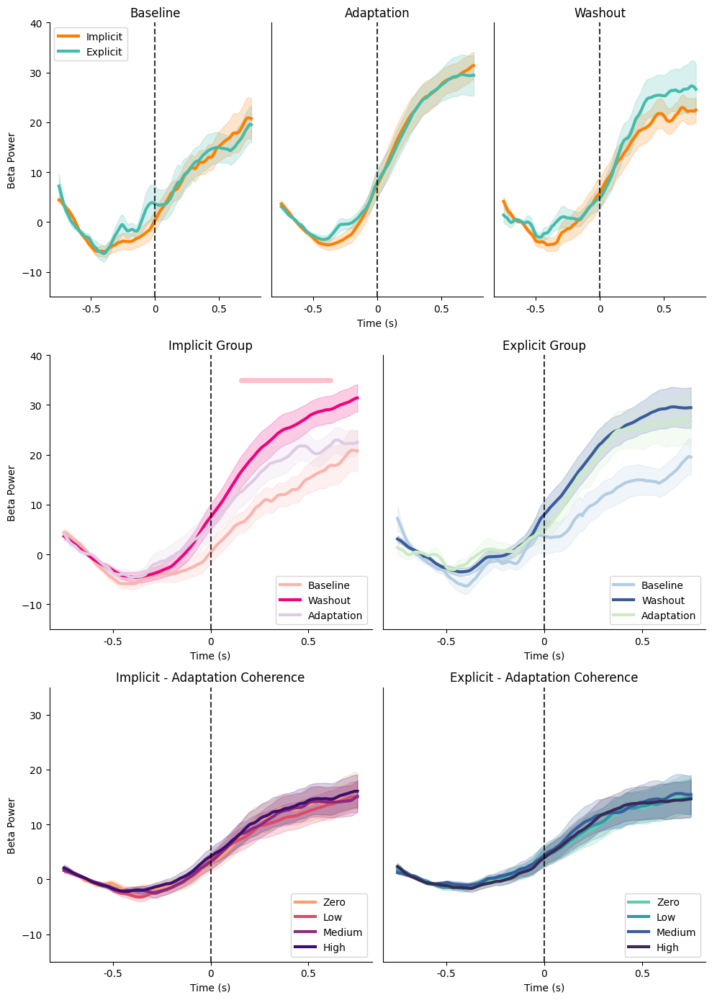

In [19]:
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import mne
from scipy.stats import sem

# Define color palettes
colors0 = sns.color_palette("magma", n_colors=6)
colors1 = sns.color_palette("mako_r", n_colors=10)
pastel = sns.color_palette("Pastel1", n_colors=6)
adapt1 = sns.color_palette("Set1", n_colors=9)
adapt2 = sns.color_palette("Accent", n_colors=8)
colors4 = sns.color_palette("magma_r", n_colors=4)  # Implicit coherence
colors5 = sns.color_palette("mako_r", n_colors=4)  # Explicit coherence

# Matching colors
colors_implicit = [pastel[0], adapt2[5], pastel[3]]  # Baseline, Washout, Adaptation
colors_explicit = [pastel[1], colors5[2], pastel[2]]  # Baseline, Washout, Adaptation
colorbl = [adapt1[4], colors1[2]]  # Colors for explicit vs implicit comparison

# Define time masks for **baseline correction** and **plotting**
baseline_mask = (time >= -0.75) & (time <= -0.5)
plot_mask = (time >= -0.75) & (time <= 0.75)

# Function for **Between-Group (Implicit vs Explicit) Comparison**
def plot_and_cluster_data_blocktype(ax, time_range, data, colors, title, xlabel, ylabel):
    data_masked = [d[:, :len(time_range)] for d in data]
    implicit_data, explicit_data = data_masked  

    for i, (name, d) in enumerate(zip(['Implicit', 'Explicit'], data_masked)):
        mean_curve = np.mean(d, axis=0)
        ax.plot(time_range, mean_curve, label=name, color=colors[i], linewidth=3)
        ax.fill_between(time_range, mean_curve - np.std(d, axis=0) / np.sqrt(d.shape[0]), 
                        mean_curve + np.std(d, axis=0) / np.sqrt(d.shape[0]), alpha=0.2, color=colors[i])

    # Cluster-based permutation test
    T_obs, clusters, cluster_p_values, H0 = mne.stats.permutation_cluster_test([explicit_data, implicit_data], n_permutations=1000)
    sig_masks = [clusters[i][0] for i in range(len(cluster_p_values)) if cluster_p_values[i] < 0.05]

    if len(sig_masks) > 0:
        for i, mask in enumerate(sig_masks):
            sig_indices = mask
            for sig_index in sig_indices:
                ax.plot(time_range[sig_index], 30, 'o', color='pink', markersize=4, alpha=0.8)

    ax.set_xlabel(xlabel)
    ax.set_ylabel(ylabel)
    ax.set_title(title)
    ax.legend(loc='lower left')

# Function for **Within-Group (Implicit/Explicit Separately) Comparison**
def plot_and_cluster_data_blocktype_within_group(ax, time_range, data, colors, title, xlabel, ylabel):
    data_masked = [d[:, :len(time_range)] for d in data]
    condition_names = ["Baseline", "Washout", "Adaptation"]

    for i, (name, d) in enumerate(zip(condition_names, data_masked)):
        mean_curve = np.mean(d, axis=0)
        ax.plot(time_range, mean_curve, label=name, color=colors[i], linewidth=3)
        ax.fill_between(time_range, mean_curve - np.std(d, axis=0) / np.sqrt(d.shape[0]), 
                        mean_curve + np.std(d, axis=0) / np.sqrt(d.shape[0]), alpha=0.2, color=colors[i])

    # Cluster-based permutation test
    T_obs, clusters, cluster_p_values, H0 = mne.stats.permutation_cluster_test([data_masked[0], data_masked[1], data_masked[2]], n_permutations=10000)
    sig_masks = [clusters[i][0] for i in range(len(cluster_p_values)) if cluster_p_values[i] < 0.05]

    if len(sig_masks) > 0:
        for i, mask in enumerate(sig_masks):
            sig_indices = mask
            for sig_index in sig_indices:
                ax.plot(time_range[sig_index], 35, 'o', color='pink', markersize=4, alpha=0.8)

    ax.set_xlabel(xlabel)
    ax.set_ylabel(ylabel)
    ax.set_title(title)
    ax.legend(loc='lower right')

# Function for **Coherence Level Analysis**
def plot_and_cluster_data_coh(ax, time_range, data, colors, title, xlabel, ylabel):
    data_masked = [d[:, :len(time_range)] for d in data]
    coherence_names = ["Zero", "Low", "Medium", "High"]

    for i, (name, d) in enumerate(zip(coherence_names, data_masked)):
        mean_curve = np.nanmean(d, axis=0)
        sem_curve = sem(d, axis=0, nan_policy='omit')
        ax.plot(time_range, mean_curve, label=name, color=colors[i], linewidth=3)
        ax.fill_between(time_range, mean_curve - sem_curve, mean_curve + sem_curve, alpha=0.2, color=colors[i])

    # Cluster-based permutation test
    T_obs, clusters, cluster_p_values, H0 = mne.stats.permutation_cluster_test(data_masked, n_permutations=10000)
    sig_masks = [clusters[i][0] for i in range(len(cluster_p_values)) if cluster_p_values[i] < 0.05]

    if len(sig_masks) > 0:
        for i, mask in enumerate(sig_masks):
            sig_indices = mask
            for sig_index in sig_indices:
                ax.plot(time_range[sig_index], 40, 'o', color='pink', markersize=4, alpha=0.8)

    ax.set_xlabel(xlabel)
    ax.set_ylabel(ylabel)
    ax.set_title(title)
    ax.legend(loc='lower right')

# Create **Figure with Three Rows**
fig = plt.figure(figsize=(10, 14))
gs = fig.add_gridspec(3, 6)  

# **First Row: Implicit vs Explicit Comparison**
ax1 = fig.add_subplot(gs[0, :2])  
ax2 = fig.add_subplot(gs[0, 2:4])  
ax3 = fig.add_subplot(gs[0, 4:6])  
plot_and_cluster_data_blocktype(ax1, time_baseline, [implicit_baseline_array, explicit_baseline_array], colorbl, "Baseline", "", "Beta Power")
plot_and_cluster_data_blocktype(ax2, time_adaptation, [implicit_adaptation_array, explicit_adaptation_array], colorbl, "Adaptation", "Time (s)", "")
plot_and_cluster_data_blocktype(ax3, time_washout, [implicit_washout_array, explicit_washout_array], colorbl, "Washout", "", "")

# axis 1 put legend top left
ax1.legend(loc='upper left')

# set the ylim for ax4 and ax5
ax1.set_ylim(-15, 40)
ax2.set_ylim(-15, 40)
ax3.set_ylim(-15, 40)

# remove y-ticks for ax2 and ax3
ax2.set_yticks([])
ax3.set_yticks([])

# remove legend from ax2 and ax3
ax2.get_legend().remove()
ax3.get_legend().remove()


# **Second Row: Within-Group Comparison**
ax4 = fig.add_subplot(gs[1, :3])  
ax5 = fig.add_subplot(gs[1, 3:])  
plot_and_cluster_data_blocktype_within_group(ax4, time_baseline, [implicit_baseline_array, implicit_adaptation_array, implicit_washout_array], colors_implicit, "Implicit Group", "Time (s)", "Beta Power")
plot_and_cluster_data_blocktype_within_group(ax5, time_baseline, [explicit_baseline_array, explicit_adaptation_array, explicit_washout_array], colors_explicit, "Explicit Group", "Time (s)", "")

# set the ylim for ax4 and ax5
ax4.set_ylim(-15, 40)
ax5.set_ylim(-15, 40)

# remove y-ticks for ax5
ax5.set_yticks([])

# **Third Row: Coherence Level Analysis**
ax6 = fig.add_subplot(gs[2, :3])  
ax7 = fig.add_subplot(gs[2, 3:])  
plot_and_cluster_data_coh(ax6, time_plot, [implicit_task_mot_zero, implicit_task_mot_low, implicit_task_mot_med, implicit_task_mot_high], colors4, "Implicit - Adaptation Coherence", "Time (s)", "Beta Power")
plot_and_cluster_data_coh(ax7, time_plot, [explicit_task_mot_zero, explicit_task_mot_low, explicit_task_mot_med, explicit_task_mot_high], colors5, "Explicit - Adaptation Coherence", "Time (s)", "")

# set the ylim for ax6 and ax7
ax6.set_ylim(-15, 35)
ax7.set_ylim(-15, 35)

# remove y-ticks for ax5
ax7.set_yticks([])

# remove right and top spines from all axes
for ax in [ax1, ax2, ax3, ax4, ax5, ax6, ax7]:
    ax.spines['right'].set_visible(False)
    ax.spines['top'].set_visible(False)
    ax.set_xticks([-0.5, 0, 0.5])  # Explicitly set tick positions
    ax.set_xticklabels(["-0.5", "0", "0.5"])  # Ensure correct labels
    ax.axvline(x=0, linestyle='dashed', color='black', alpha=0.8)  # Add vertical dashed line
    ax.spines['right'].set_visible(False)
    ax.spines['top'].set_visible(False)
    
plt.tight_layout()
plt.show()


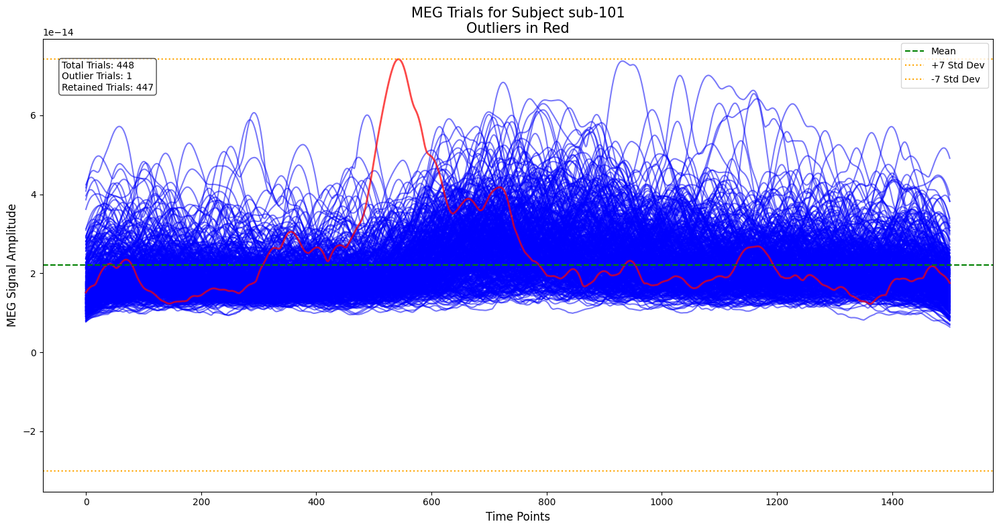

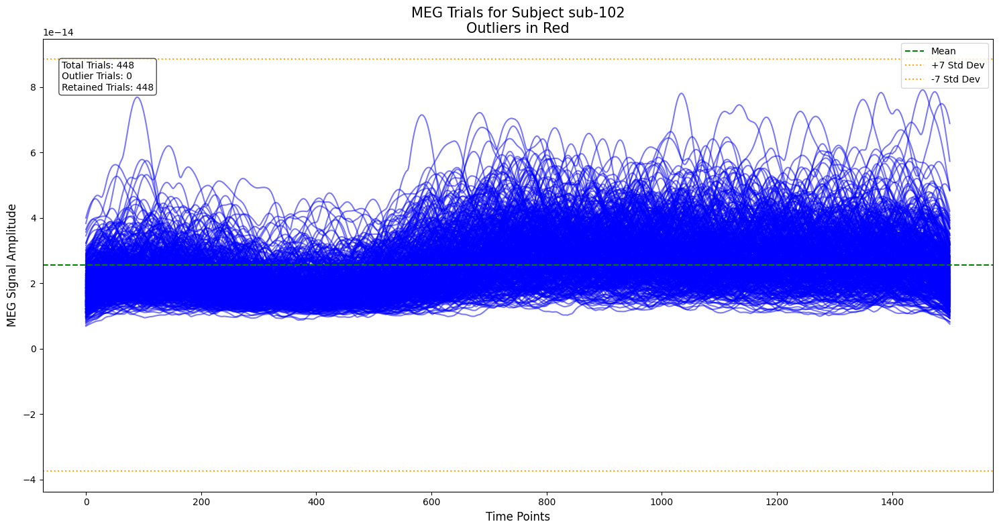

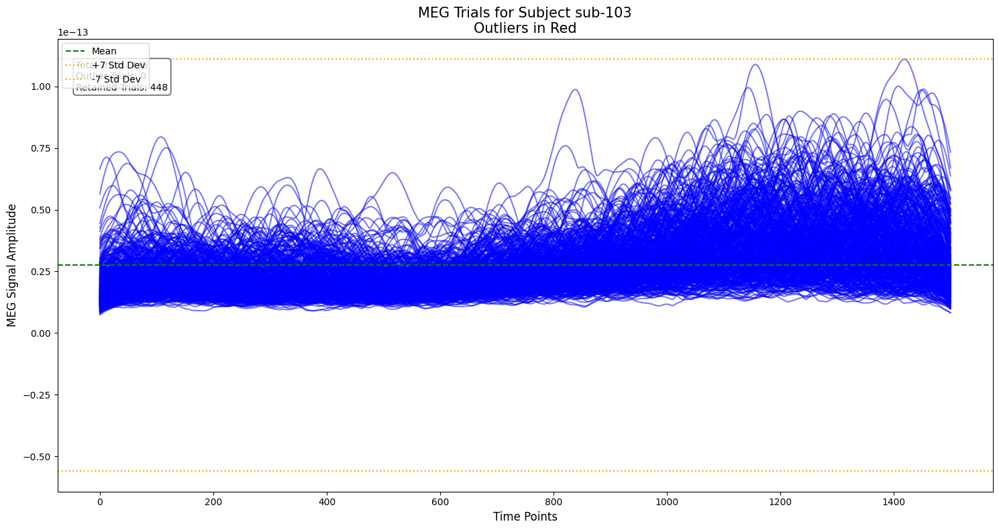

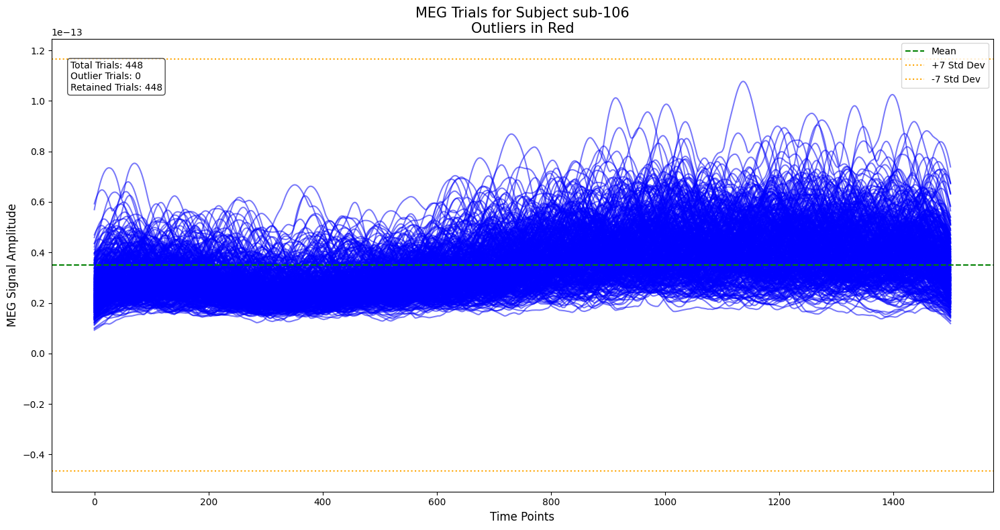

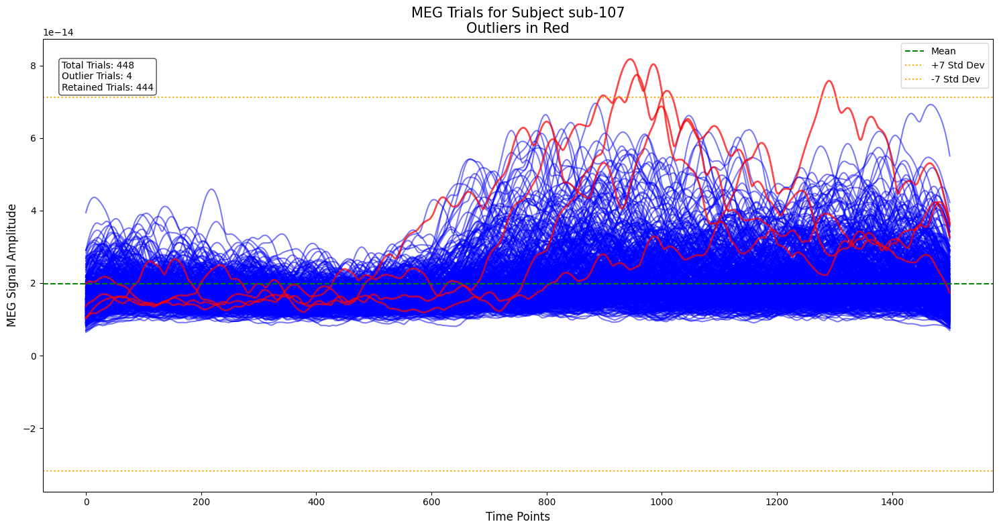

...

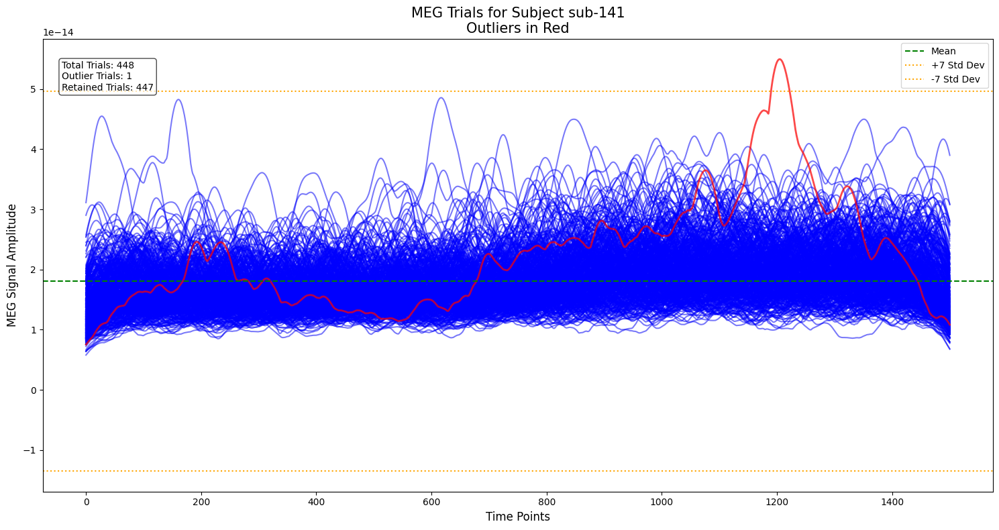

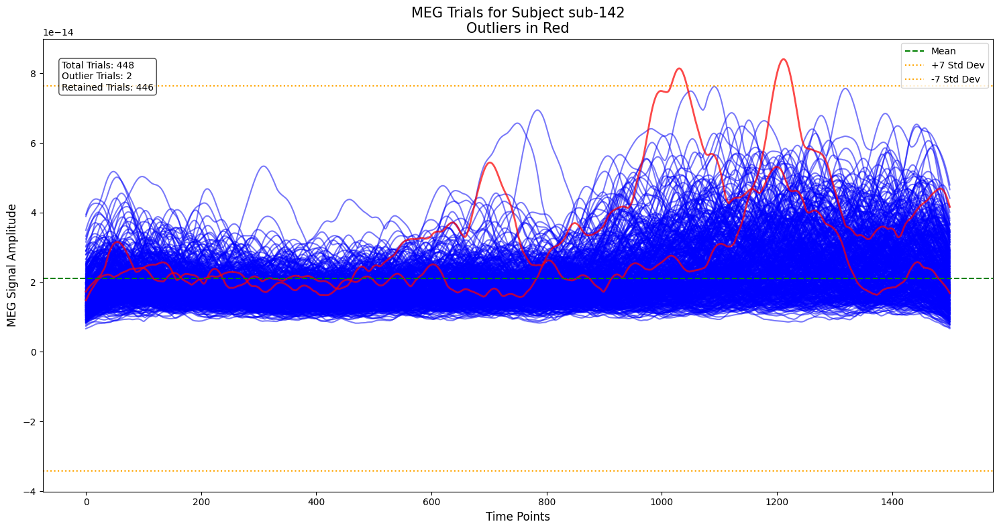

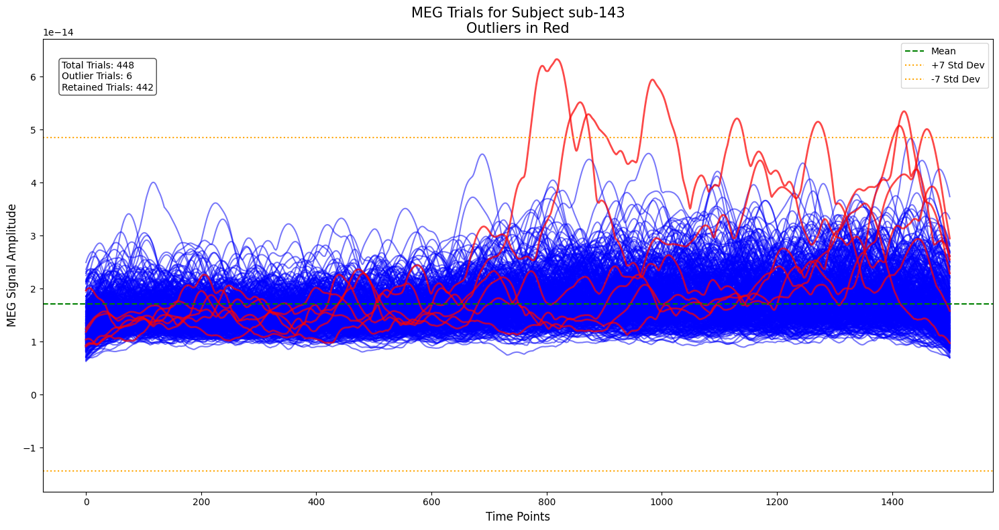

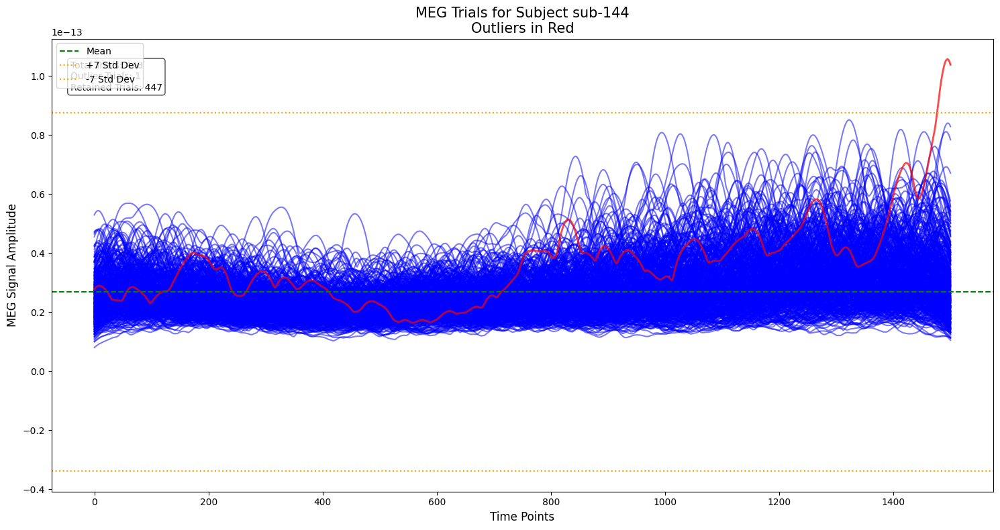

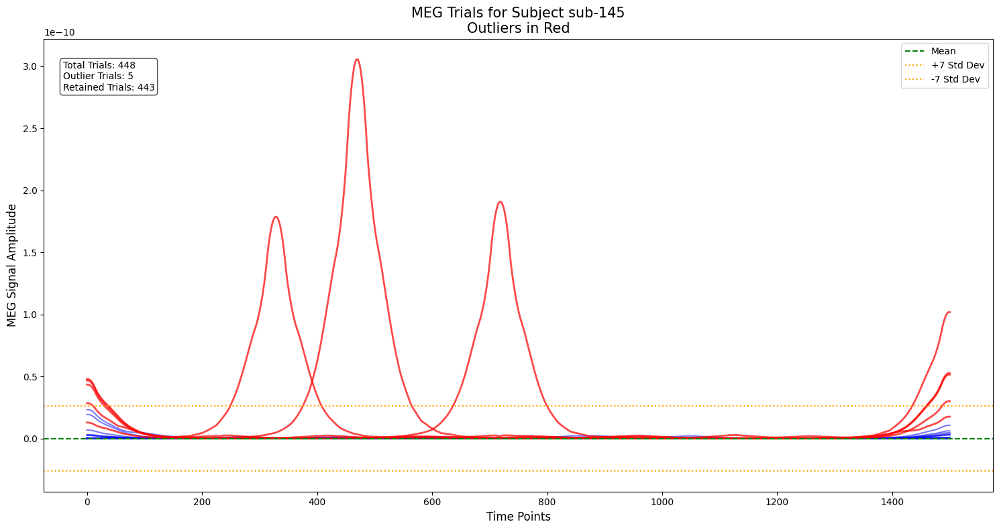

In [20]:
# Iterate through each subject
for selected_subject in subject_ids:
    # Repeat the original data loading and processing steps
    subject_files = [f for f in files if selected_subject in f]
    epochs_list = [CustomUnpickler(open(os.path.join(data_dir, f), "rb")).load() for f in subject_files]

    all_meg_data = {}
    for epochs in epochs_list:
        for sensor, data in epochs.items():
            all_meg_data.setdefault(sensor, []).append(data)

    time = epochs['time']
    for sensor in all_meg_data:
        valid_arrays = [arr for arr in all_meg_data[sensor] if isinstance(arr, np.ndarray) and arr.ndim == 2 and arr.shape[1] == 1501]
        all_meg_data[sensor] = np.concatenate(valid_arrays, axis=0) if valid_arrays else None

    all_meg_data = {ch: data for ch, data in all_meg_data.items() if data is not None}

    data_all_trials = np.stack(list(all_meg_data.values()))
    grand_avg_per_trial = np.mean(data_all_trials, axis=0)

    # Create MEG DataFrame
    meg_df = pd.DataFrame({
        'subject': selected_subject,
        'trial': np.arange(grand_avg_per_trial.shape[0]),
        'meg_signal': [arr for arr in grand_avg_per_trial]
    })

    # Get behavioral data for this subject
    behav_subject_data = behav_df[behav_df['subject'] == selected_subject].reset_index(drop=True)

    # Identify common trials
    common_trials = set(meg_df['trial']).intersection(set(behav_subject_data.index))
    common_trials_sorted = sorted(list(common_trials))

    # Filter both MEG and behavioral data
    meg_df = meg_df[meg_df['trial'].isin(common_trials_sorted)].reset_index(drop=True)
    behav_subject_data = behav_subject_data.loc[common_trials_sorted].reset_index(drop=True)

    # Merge MEG and behavioral data
    merged_df = pd.concat([behav_subject_data, meg_df.drop(columns=['subject'])], axis=1)

    # Create a copy of the original merged DataFrame
    original_merged_df = merged_df.copy()

    # Compute mean and standard deviation
    all_meg_values = np.concatenate(merged_df['meg_signal'].values)
    subject_mean = np.mean(all_meg_values)
    subject_std = np.std(all_meg_values)

    # Outlier detection function
    def is_outlier(trial_signal):
        return np.any(np.abs(trial_signal - subject_mean) > 7 * subject_std)

    # Identify outlier trials
    outlier_mask = merged_df['meg_signal'].apply(is_outlier)

    # Visualization
    plt.figure(figsize=(15, 8))
    
    # Prepare time series extraction
    def extract_time_series(meg_signal):
        return meg_signal.flatten()
    
    # Plot all original trials in light gray
    for trial in original_merged_df['meg_signal']:
        plt.plot(extract_time_series(trial), color='lightgray', alpha=0.3, linewidth=1)
    
    # Plot non-outlier trials in blue
    non_outlier_df = merged_df[~outlier_mask]
    for trial in non_outlier_df['meg_signal']:
        plt.plot(extract_time_series(trial), color='blue', alpha=0.5, linewidth=1.5)
    
    # Plot outlier trials in red
    outlier_trials = original_merged_df[outlier_mask]['meg_signal']
    for trial in outlier_trials:
        plt.plot(extract_time_series(trial), color='red', alpha=0.7, linewidth=2)
    
    # Add horizontal lines for mean and standard deviation bounds
    plt.axhline(y=subject_mean, color='green', linestyle='--', label='Mean')
    plt.axhline(y=subject_mean + 7*subject_std, color='orange', linestyle=':', label='+7 Std Dev')
    plt.axhline(y=subject_mean - 7*subject_std, color='orange', linestyle=':', label='-7 Std Dev')
    
    # Customize plot
    plt.title(f'MEG Trials for Subject {selected_subject}\nOutliers in Red', fontsize=15)
    plt.xlabel('Time Points', fontsize=12)
    plt.ylabel('MEG Signal Amplitude', fontsize=12)
    plt.legend()
    
    # Add text annotation with trial counts
    total_trials = len(original_merged_df)
    outlier_count = len(outlier_trials)
    retained_count = total_trials - outlier_count
    plt.text(0.02, 0.95, f'Total Trials: {total_trials}\nOutlier Trials: {outlier_count}\nRetained Trials: {retained_count}', 
             transform=plt.gca().transAxes, 
             verticalalignment='top', 
             bbox=dict(boxstyle='round', facecolor='white', alpha=0.7))
    
    plt.tight_layout()
    plt.show()

    # Continue with the original outlier removal for further processing
    merged_df = merged_df[~merged_df['meg_signal'].apply(is_outlier)].reset_index(drop=True)